# Introduction

---

This notebook presents an implementation of an analysis method for detecting and understanding artefacts in MNLI datasets.

---




# Install dependencies

In [ ]:
%pip install datasets

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 492.2/492.2 kB 4.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.3/115.3 kB 3.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 212.5/212.5 kB 10.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 7.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 14.2 MB/s eta 0:00:00


# Import

In [ ]:
# Standard library imports
from collections import Counter, defaultdict
import string
from typing import List, Tuple
import re

# Third-party imports
from datasets import load_dataset
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
import numpy as np
import pandas as pd
import plotly.graph_objects as go
import seaborn as sns
from scipy.stats import norm
import spacy
import nltk
nltk.download('punkt')


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

# Load and preprocess dataset

In [ ]:
# Load the MNLI dataset from HuggingFace
mnli = load_dataset('multi_nli')

# Convert the dataset to a pandas dataframe
mnli_train = pd.DataFrame(mnli['train'])

# Convert the numerical labels to textual labels for clarity
# Change the labels from 0, 1, 2 to 'entailment', 'neutral', 'contradiction'
mnli_train['label'] = mnli_train['label'].replace({0: 'entailment', 1: 'neutral', 2: 'contradiction'})

# Remove instances where the label is '-1'. These are the instances where the annotators disagreed
mnli_train = mnli_train[mnli_train['label'] != -1]

def preprocess(sentence: str) -> List[str]:
    """
    Function to preprocess a given sentence.

    Parameters:
    sentence (str): The sentence to be preprocessed.

    Returns:
    List[str]: List of tokens in the preprocessed sentence.
    """
    # Remove punctuation
    translator = str.maketrans('', '', string.punctuation)
    sentence_no_punct = sentence.translate(translator)

    # Tokenize on whitespace
    tokens = sentence_no_punct.lower().split()

    return tokens

# keep only the necessary columns
mnli_train = mnli_train[['pairID', 'premise', 'hypothesis', 'genre', 'label']]

# Apply the preprocess function to the 'hypothesis' column of the DataFrame
# The result is a new column 'tokens' containing the tokenized hypothesis
mnli_train['tokens'] = mnli_train['hypothesis'].apply(preprocess)

Generating train split:   0%|          | 0/392702 [00:00<?, ? examples/s]

Generating validation_matched split:   0%|          | 0/9815 [00:00<?, ? examples/s]

Generating validation_mismatched split:   0%|          | 0/9832 [00:00<?, ? examples/s]

In [ ]:
mnli_train

,pairID,premise,hypothesis,genre,label,tokens
0,31193n,Conceptually cream skimming has two basic dime...,Product and geography are what make cream skim...,government,neutral,"[product, and, geography, are, what, make, cre..."
1,101457e,you know during the season and i guess at at y...,You lose the things to the following level if ...,telephone,entailment,"[you, lose, the, things, to, the, following, l..."
2,134793e,One of our number will carry out your instruct...,A member of my team will execute your orders w...,fiction,entailment,"[a, member, of, my, team, will, execute, your,..."
3,37397e,How do you know? All this is their information...,This information belongs to them.,fiction,entailment,"[this, information, belongs, to, them]"
4,50563n,yeah i tell you what though if you go price so...,The tennis shoes have a range of prices.,telephone,neutral,"[the, tennis, shoes, have, a, range, of, prices]"
...,...,...,...,...,...,...
392697,30418c,"Clearly, California can - and must - do better.",California cannot do any better.,government,contradiction,"[california, cannot, do, any, better]"
392698,105454n,It was once regarded as the most beautiful str...,So many of the original buildings had been rep...,travel,neutral,"[so, many, of, the, original, buildings, had, ..."
392699,13960e,Houseboats are a beautifully preserved traditi...,The tradition of houseboats originated while t...,travel,entailment,"[the, tradition, of, houseboats, originated, w..."
392700,114061n,Obituaries fondly recalled his on-air debates ...,The obituaries were beautiful and written in k...,slate,neutral,"[the, obituaries, were, beautiful, and, writte..."


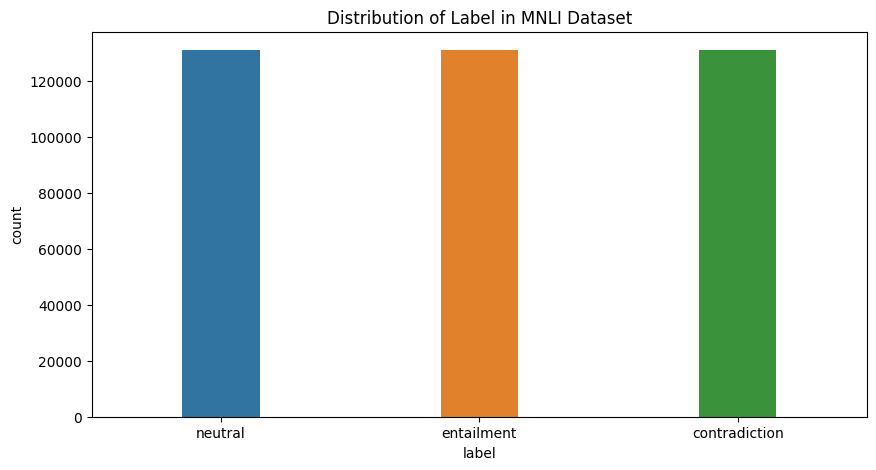

In [ ]:
# plot the label counts

plt.figure(figsize=(10,5))
sns.countplot(data=mnli_train, x='label', width=0.3)
plt.title('Distribution of Label in MNLI Dataset')
plt.show()

# Artefacts detection using Z-statistic test

---

This analysis is based on the research paper titled **"Competency Problems: On Finding and Removing Artifacts in Language Data"**.

In NLP tasks, datasets often contain subtle biases or artefacts that models may exploit to make predictions. These biases aren't always evident upon cursory inspection and may lead to overestimated performance metrics as models rely on them rather than learning the intended linguistic phenomena.

The research paper this notebook refers to proposes a method for detecting these dataset artefacts using statistical techniques. **The approach is grounded on the calculation of Z-statistics for each token in the dataset, considering each label. A token with a Z-statistic that significantly deviates from what we would expect under a null hypothesis is considered a potential artefact.**

***This notebook covers the process of loading and preprocessing the dataset, calculating token statistics, and using these statistics to identify potential artefacts.*** It also provides a visualization of these artefacts, offering insights into how they distribute across different labels in the dataset.

---

## Prepare Hypothesis Token statistics

In [ ]:
# Get a list of unique labels in the dataset
labels = mnli_train['label'].unique().tolist()

In [ ]:
# Initialize Counters
token_counts = Counter()


# token_label_counts is a defaultdict of Counters.
# For each label, it will hold a Counter that contains the count of each token for that label.
token_label_counts = defaultdict(Counter)

for i, row in mnli_train.iterrows():
    token_counts.update(row['tokens'])
    token_label_counts[row['label']].update(row['tokens'])

# Create a DataFrame for token statistics
token_df = pd.DataFrame.from_dict(token_counts, orient='index', columns=['total_count'])
token_df.index.name = 'token'
token_df.reset_index(inplace=True)

## Calculate Conditional Probabilities for label given token

In [ ]:
# For each label, we add two new columns to the DataFrame:
# 1. A count column, which indicates how many times each token appears with that label
# 2. A probability column, which is the count for each token and label divided by the total count for that token

# Iterate over all unique labels
for label in labels:
    token_df[f'{label}_count'] = token_df['token'].map(token_label_counts[label])
    token_df[f'{label}_prob'] = token_df[f'{label}_count'] / token_df['total_count']


In [ ]:
token_df

,token,total_count,neutral_count,neutral_prob,entailment_count,entailment_prob,contradiction_count,contradiction_prob
0,product,529,186,0.351607,179,0.338374,164,0.310019
1,and,59257,19978,0.337142,20596,0.347571,18683,0.315288
2,geography,34,11,0.323529,15,0.441176,8,0.235294
3,are,40960,14816,0.361719,13369,0.326392,12775,0.311890
4,what,8318,2706,0.325319,3130,0.376292,2482,0.298389
...,...,...,...,...,...,...,...,...
62252,wranglerloving,1,1,1.000000,0,0.000000,0,0.000000
62253,reasserting,1,1,1.000000,0,0.000000,0,0.000000
62254,léon,1,0,0.000000,0,0.000000,1,1.000000
62255,barb,1,0,0.000000,1,1.000000,0,0.000000


## Calculate Z-Statistics for each token in each label

In [ ]:
# Set the null hypothesis probability
# The null hypothesis in this context is that the labels are evenly distributed among the tokens.
# So, we calculate the probability under the null hypothesis (p0) by dividing 1 by the number of unique labels.
p0 = 1 / len(labels)

'''
Calculate the z-statistics for each label
The z-statistic is a measure of how much the observed probability deviates from the expected probability
under the null hypothesis.
A high absolute value of the z-statistic indicates that the observed probability
significantly deviates from the expected probability, which may suggest the presence of a bias or artifact.
We calculate the z-statistic for each label and add it as a new column in the DataFrame.
'''

# This specific z_stat is not used directly in the analysis (this is done only for reference and understanding)
for label in labels:
    token_df[f'{label}_z_stat'] = (token_df[f'{label}_prob'] - p0) / np.sqrt((p0 * (1 - p0)) / token_df['total_count'])


In [ ]:
token_df

,token,total_count,neutral_count,neutral_prob,entailment_count,entailment_prob,contradiction_count,contradiction_prob,neutral_z_stat,entailment_z_stat,contradiction_z_stat
0,product,529,186,0.351607,179,0.338374,164,0.310019,0.891569,0.245950,-1.137520
1,and,59257,19978,0.337142,20596,0.347571,18683,0.315288,1.966545,7.352031,-9.318576
2,geography,34,11,0.323529,15,0.441176,8,0.235294,-0.121268,1.333946,-1.212678
3,are,40960,14816,0.361719,13369,0.326392,12775,0.311890,12.186570,-2.980259,-9.206311
4,what,8318,2706,0.325319,3130,0.376292,2482,0.298389,-1.550621,8.311326,-6.760706
...,...,...,...,...,...,...,...,...,...,...,...
62252,wranglerloving,1,1,1.000000,0,0.000000,0,0.000000,1.414214,-0.707107,-0.707107
62253,reasserting,1,1,1.000000,0,0.000000,0,0.000000,1.414214,-0.707107,-0.707107
62254,léon,1,0,0.000000,0,0.000000,1,1.000000,-0.707107,-0.707107,1.414214
62255,barb,1,0,0.000000,1,1.000000,0,0.000000,-0.707107,1.414214,-0.707107


## Calculate the Threshold for rejecting null

---

1. Choose a significance level. it's the maximum probability of making a Type I error (false positive) that we're willing to accept.
2. Calculate the number of tests (unique tokens in the DataFrame). We need this for the Bonferroni correction, which adjusts the significance level to control the family-wise error rate when performing multiple tests.
3. Apply the Bonferroni correction. The Bonferroni correction is a method used to counteract the problem of multiple comparisons.It adjusts the significance level by dividing it by the number of tests. This makes the significance threshold more stringent, reducing the probability of false positives.
4. Calculate the z-statistic threshold. The z-statistic threshold is the value that the z-statistic must exceed for us to reject the null hypothesis at the chosen significance level. It's calculated using the inverse of the cumulative distribution function (quantile function) of the standard normal distribution.
5. Calculate the overall threshold above which the null hypothesis can be rejected.Tokens with an observed probability greater than this threshold are considered significant at the chosen significance level. This line ensures the threshold is between 0 and 1 by applying the np.minimum and np.maximum functions.
6. Calculate the threshold for each token. This calculation is similar to the overall threshold calculation but it's done for each token individually.
The resulting 'threshold' column in the DataFrame gives the threshold for each token.

---

In [ ]:
alpha = 0.01
num_tests = len(token_df)

# do the correction only when the number of tests are larger
alpha_bonferroni = alpha / num_tests

# Calculate the z-statistic threshold
z_star = norm.ppf(1 - alpha_bonferroni / 2)

# Calculate the overall threshold
threshold = np.minimum(1, np.maximum(0, p0 + z_star / (2 * np.sqrt(token_df['total_count'].sort_values()))))

# Calculate the threshold for each token
token_df['threshold'] = np.minimum(1, np.maximum(0, p0 + z_star / (2 * np.sqrt(token_df['total_count']))))

# token_df['threshold'] = p0 + z_star * np.sqrt((p0 * (1 - p0)) / token_df['total_count'])




In [ ]:
z_star

5.239944947912947

In [ ]:
token_df

,token,total_count,neutral_count,neutral_prob,entailment_count,entailment_prob,contradiction_count,contradiction_prob,neutral_z_stat,entailment_z_stat,contradiction_z_stat,threshold
0,product,529,186,0.351607,179,0.338374,164,0.310019,0.891569,0.245950,-1.137520,0.447245
1,and,59257,19978,0.337142,20596,0.347571,18683,0.315288,1.966545,7.352031,-9.318576,0.344096
2,geography,34,11,0.323529,15,0.441176,8,0.235294,-0.121268,1.333946,-1.212678,0.782655
3,are,40960,14816,0.361719,13369,0.326392,12775,0.311890,12.186570,-2.980259,-9.206311,0.346279
4,what,8318,2706,0.325319,3130,0.376292,2482,0.298389,-1.550621,8.311326,-6.760706,0.362060
...,...,...,...,...,...,...,...,...,...,...,...,...
62252,wranglerloving,1,1,1.000000,0,0.000000,0,0.000000,1.414214,-0.707107,-0.707107,1.000000
62253,reasserting,1,1,1.000000,0,0.000000,0,0.000000,1.414214,-0.707107,-0.707107,1.000000
62254,léon,1,0,0.000000,0,0.000000,1,1.000000,-0.707107,-0.707107,1.414214,1.000000
62255,barb,1,0,0.000000,1,1.000000,0,0.000000,-0.707107,1.414214,-0.707107,1.000000


# Plot Interactive Artefacts map

In [ ]:
# Create an interactive scatter plot using Plotly

# Define a new figure
fig = go.Figure()

# Define a dictionary of colors for each label
colors = {'entailment': 'green', 'neutral': 'blue', 'contradiction': 'red', 'grey': 'grey'}

# Plot the observed probabilities for each token and label
for label in labels:
    # Get the DataFrame for the current label
    data_label = token_df

    # Determine which points are above the threshold
    # This creates a Boolean Series where each element is True if the observed probability is
    # above the threshold, and False otherwise
    is_above_threshold = data_label[f'{label}_prob'] > data_label['threshold']

    # Add scatter plots for points above and below the threshold
    # Points above the threshold are colored according to the label, and
    # points below the threshold are colored grey
    for condition, color in zip([is_above_threshold, ~is_above_threshold], [colors[label], 'grey']):
        token = data_label[condition]['token']
        text = [f"Label: {label}<br>Token: {t}" for t in token]
        fig.add_trace(go.Scatter(
            x = data_label[condition]['total_count'],
            y = data_label[condition][f'{label}_prob'],
            mode = 'markers',
            name = label if color != 'grey' else None,
            marker = dict(
                color = color,
                size = 4
            ),
            text = text,
            hovertemplate = "%{text}<br>Occurrences: %{x}<br>Observed probabilities: %{y}<extra></extra>"
        ))

# Add the threshold line to the plot
fig.add_trace(go.Scatter(
    x = token_df['total_count'].sort_values(),
    y = threshold,
    mode = 'lines',
    name = f'alpha={alpha}/{num_tests}',
    line = dict(color='blue')
))

# Set the scale of the x-axis to logarithmic and limit its range
fig.update_xaxes(type='log', range=[0.8, np.log10(max(token_df['total_count']))])

# Set the labels for the x and y axes, and the title for the plot
fig.update_layout(
    xaxis_title='n',
    yaxis_title='p(y|x)',
    title='Artefacts in MNLI dataset'
)

# Display the plot
fig.show()


In [ ]:
fig.write_html('mnli_artefacts_interactive_chart.html')

# Plot Static Map

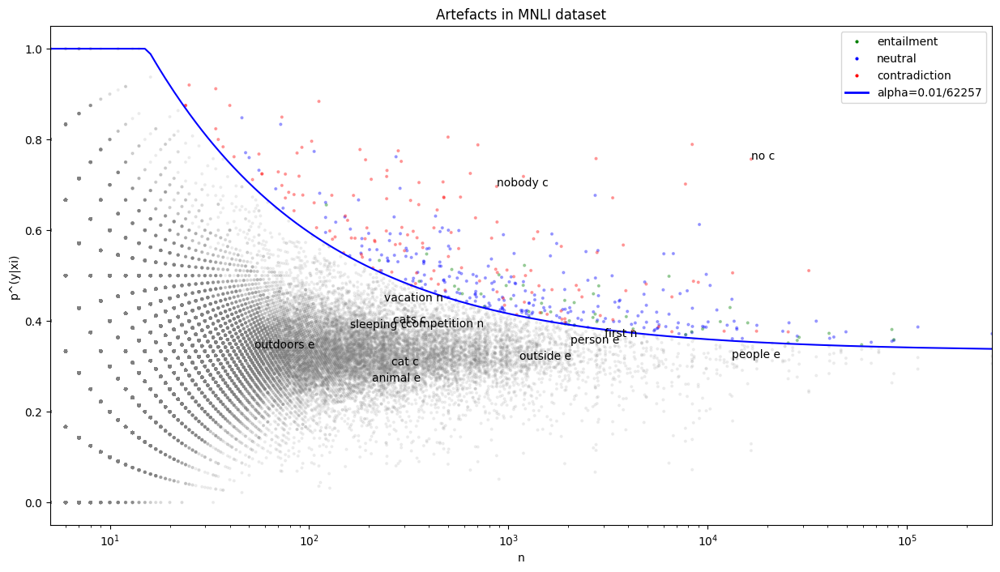

In [ ]:
# Define the figure and axes for the plot
fig, ax = plt.subplots(figsize=(15,8))

# Define a dictionary of colors for each label
colors = {'entailment': 'g', 'neutral': 'b', 'contradiction': 'r', 'grey': 'grey'}

# Define a dictionary of words to annotate in the plot for each label
token_label_annotate_dict = {
    'contradiction': ['nobody', 'cats', 'cat', 'no', 'sleeping'],
    'neutral': ['vacation', 'first', 'competition'],
    'entailment': ['outdoors', 'animal', 'outside', 'person', 'people']
}

# Plot the observed probabilities for each token and label
for label in labels:
    # Create a condition series to find which points are above the threshold
    is_above_threshold = token_df[f'{label}_prob'] > token_df['threshold']

    # Create a color and alpha series based on the condition series
    color_series = pd.Series(colors['grey'], index=token_df.index)
    color_series[is_above_threshold] = colors[label]

    alpha_series = pd.Series(0.1, index=token_df.index)
    alpha_series[is_above_threshold] = 0.3

    # Plot the points for this label
    ax.scatter(token_df['total_count'], token_df[f'{label}_prob'], c=color_series, alpha=alpha_series, s=4)

    # # Add annotations for selected words
    for token in set(token_label_annotate_dict[label]) & set(token_df['token']):
        x = token_df.loc[token_df['token'] == token, 'total_count'].values[0]
        y = token_df.loc[token_df['token'] == token, f'{label}_prob'].values[0]
        ax.annotate(f'{token} {label[0]}', (x, y))

# Add the threshold line to the plot
ax.plot(token_df['total_count'].sort_values(), threshold, 'b-', label=f'alpha=0.01/{num_tests}')

# Adjust x-axis to be logarithmic and limit its range
ax.set_xscale('log')
ax.set_xlim([10**0.7, max(token_df['total_count'])])

# Hide the first x-axis label
ax.xaxis.get_major_ticks()[0].label1.set_visible(False)

# Set the labels for the x and y axes, and the title for the plot
ax.set_xlabel('n')
ax.set_ylabel('p^(y|xi)')
ax.set_title('Artefacts in MNLI dataset')

# Create custom legend
legend_elements = [Line2D([0], [0], marker='o', color='w', label=label,
                          markerfacecolor=color, markersize=4) for label, color in colors.items() if label != 'grey']
legend_elements.append(Line2D([0], [0], color='b', lw=2, label=f'alpha={alpha}/{num_tests}'))  # Add threshold line to legend
ax.legend(handles=legend_elements, loc='upper right')

# Display the plot
plt.show()


In [ ]:
# plt.savefig('mnli_artefacts_chart.png', bbox_inches='tight')

# Artefacts analysis

In [ ]:
artefact_dfs_list = []
for label in labels:
    # Create a condition series to find which points are above the threshold
    df = token_df[token_df[f'{label}_prob'] > token_df['threshold']]
    artefact_dfs_list.append(df)

arte_df = pd.concat(artefact_dfs_list)

In [ ]:
arte_df

,token,total_count,neutral_count,neutral_prob,entailment_count,entailment_prob,contradiction_count,contradiction_prob,neutral_z_stat,entailment_z_stat,contradiction_z_stat,threshold
3,are,40960,14816,0.361719,13369,0.326392,12775,0.311890,12.186570,-2.980259,-9.206311,0.346279
5,make,4680,1966,0.420085,1431,0.305769,1283,0.274145,12.589526,-4.000120,-8.589405,0.371631
8,work,5383,2036,0.378228,1716,0.318781,1631,0.302991,6.987323,-2.264856,-4.722467,0.369043
11,the,267617,99512,0.371845,86224,0.322192,81881,0.305963,42.262345,-12.226679,-30.035666,0.338398
12,things,3602,1437,0.398945,1325,0.367851,840,0.233204,8.353325,4.394627,-12.747952,0.376987
...,...,...,...,...,...,...,...,...,...,...,...,...
15175,universally,35,4,0.114286,3,0.085714,28,0.800000,-2.749026,-3.107594,5.856620,0.776190
16195,luckily,73,12,0.164384,10,0.136986,51,0.698630,-3.062142,-3.558705,6.620847,0.639978
19324,slightest,34,5,0.147059,1,0.029412,28,0.823529,-2.304088,-3.759302,6.063391,0.782655
19731,intact,89,15,0.168539,10,0.112360,64,0.719101,-3.297939,-4.422237,7.720176,0.611050


In [ ]:
token_df

,token,total_count,neutral_count,neutral_prob,entailment_count,entailment_prob,contradiction_count,contradiction_prob,neutral_z_stat,entailment_z_stat,contradiction_z_stat,threshold
0,product,529,186,0.351607,179,0.338374,164,0.310019,0.891569,0.245950,-1.137520,0.447245
1,and,59257,19978,0.337142,20596,0.347571,18683,0.315288,1.966545,7.352031,-9.318576,0.344096
2,geography,34,11,0.323529,15,0.441176,8,0.235294,-0.121268,1.333946,-1.212678,0.782655
3,are,40960,14816,0.361719,13369,0.326392,12775,0.311890,12.186570,-2.980259,-9.206311,0.346279
4,what,8318,2706,0.325319,3130,0.376292,2482,0.298389,-1.550621,8.311326,-6.760706,0.362060
...,...,...,...,...,...,...,...,...,...,...,...,...
62252,wranglerloving,1,1,1.000000,0,0.000000,0,0.000000,1.414214,-0.707107,-0.707107,1.000000
62253,reasserting,1,1,1.000000,0,0.000000,0,0.000000,1.414214,-0.707107,-0.707107,1.000000
62254,léon,1,0,0.000000,0,0.000000,1,1.000000,-0.707107,-0.707107,1.414214,1.000000
62255,barb,1,0,0.000000,1,1.000000,0,0.000000,-0.707107,1.414214,-0.707107,1.000000


In [ ]:
token = 'no'
label = 'contradiction'

print(f"Total count : {token_df[token_df['token']==token]['total_count'].iloc[0]}")
print(f"{label} count for {token} : {token_df[token_df['token']==token][f'{label}_count'].iloc[0]}")
print(f"{label} Prob for {token} : {token_df[token_df['token']==token][f'{label}_prob'].iloc[0]}")
print(f"Z stat for {token} : {token_df[token_df['token']==token][f'{label}_z_stat'].iloc[0]}")
print(f"Threshold for the given token \"{token}\" : {token_df[token_df['token']==token]['threshold'].iloc[0]}")


Total count : 16524
contradiction count for no : 12502
contradiction Prob for no : 0.7565964657467925
Z stat for no : 115.418198592981
Threshold for the given token "no" : 0.35371497375546024


In [ ]:
# Create a list to store DataFrames of tokens that are considered artefacts for each label
artefact_dfs = []

# Iterate over all labels
for label in labels:
    # For each label, filter the DataFrame to only include rows where
    # the observed probability is greater than the threshold
    # These tokens are considered artefacts for the current label
    # Append the resulting DataFrame to the list
    artefact_dfs.append(token_df[token_df[f'{label}_prob'] > token_df['threshold']])

# Concatenate all the DataFrames in the list into a single DataFrame
# This DataFrame contains all tokens that are considered artefacts for any label
artefacts_df = pd.concat(artefact_dfs)

# Display the DataFrame
artefacts_df


,token,total_count,neutral_count,neutral_prob,entailment_count,entailment_prob,contradiction_count,contradiction_prob,neutral_z_stat,entailment_z_stat,contradiction_z_stat,threshold
3,are,40960,14816,0.361719,13369,0.326392,12775,0.311890,12.186570,-2.980259,-9.206311,0.346279
5,make,4680,1966,0.420085,1431,0.305769,1283,0.274145,12.589526,-4.000120,-8.589405,0.371631
8,work,5383,2036,0.378228,1716,0.318781,1631,0.302991,6.987323,-2.264856,-4.722467,0.369043
11,the,267617,99512,0.371845,86224,0.322192,81881,0.305963,42.262345,-12.226679,-30.035666,0.338398
12,things,3602,1437,0.398945,1325,0.367851,840,0.233204,8.353325,4.394627,-12.747952,0.376987
...,...,...,...,...,...,...,...,...,...,...,...,...
15175,universally,35,4,0.114286,3,0.085714,28,0.800000,-2.749026,-3.107594,5.856620,0.776190
16195,luckily,73,12,0.164384,10,0.136986,51,0.698630,-3.062142,-3.558705,6.620847,0.639978
19324,slightest,34,5,0.147059,1,0.029412,28,0.823529,-2.304088,-3.759302,6.063391,0.782655
19731,intact,89,15,0.168539,10,0.112360,64,0.719101,-3.297939,-4.422237,7.720176,0.611050


In [ ]:
# Add a new column that indicates which labels a token is significantly correlated with
artefacts_df["correlated_to"] = artefacts_df.apply(
    lambda row: [label for label in labels if row[f'{label}_prob'] > row['threshold']], axis=1
    )

# Display the updated DataFrame
artefacts_df


,token,total_count,neutral_count,neutral_prob,entailment_count,entailment_prob,contradiction_count,contradiction_prob,neutral_z_stat,entailment_z_stat,contradiction_z_stat,threshold,correlated_to
3,are,40960,14816,0.361719,13369,0.326392,12775,0.311890,12.186570,-2.980259,-9.206311,0.346279,[neutral]
5,make,4680,1966,0.420085,1431,0.305769,1283,0.274145,12.589526,-4.000120,-8.589405,0.371631,[neutral]
8,work,5383,2036,0.378228,1716,0.318781,1631,0.302991,6.987323,-2.264856,-4.722467,0.369043,[neutral]
11,the,267617,99512,0.371845,86224,0.322192,81881,0.305963,42.262345,-12.226679,-30.035666,0.338398,[neutral]
12,things,3602,1437,0.398945,1325,0.367851,840,0.233204,8.353325,4.394627,-12.747952,0.376987,[neutral]
...,...,...,...,...,...,...,...,...,...,...,...,...,...
15175,universally,35,4,0.114286,3,0.085714,28,0.800000,-2.749026,-3.107594,5.856620,0.776190,[contradiction]
16195,luckily,73,12,0.164384,10,0.136986,51,0.698630,-3.062142,-3.558705,6.620847,0.639978,[contradiction]
19324,slightest,34,5,0.147059,1,0.029412,28,0.823529,-2.304088,-3.759302,6.063391,0.782655,[contradiction]
19731,intact,89,15,0.168539,10,0.112360,64,0.719101,-3.297939,-4.422237,7.720176,0.611050,[contradiction]


In [ ]:
# Add a column to get the number of correlated labels for each token
artefacts_df['num_correlated_labels'] = artefacts_df['correlated_to'].apply(lambda x: len(x))

# Display Dataframe
artefacts_df

,token,total_count,neutral_count,neutral_prob,entailment_count,entailment_prob,contradiction_count,contradiction_prob,neutral_z_stat,entailment_z_stat,contradiction_z_stat,threshold,correlated_to,num_correlated_labels
3,are,40960,14816,0.361719,13369,0.326392,12775,0.311890,12.186570,-2.980259,-9.206311,0.346279,[neutral],1
5,make,4680,1966,0.420085,1431,0.305769,1283,0.274145,12.589526,-4.000120,-8.589405,0.371631,[neutral],1
8,work,5383,2036,0.378228,1716,0.318781,1631,0.302991,6.987323,-2.264856,-4.722467,0.369043,[neutral],1
11,the,267617,99512,0.371845,86224,0.322192,81881,0.305963,42.262345,-12.226679,-30.035666,0.338398,[neutral],1
12,things,3602,1437,0.398945,1325,0.367851,840,0.233204,8.353325,4.394627,-12.747952,0.376987,[neutral],1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15175,universally,35,4,0.114286,3,0.085714,28,0.800000,-2.749026,-3.107594,5.856620,0.776190,[contradiction],1
16195,luckily,73,12,0.164384,10,0.136986,51,0.698630,-3.062142,-3.558705,6.620847,0.639978,[contradiction],1
19324,slightest,34,5,0.147059,1,0.029412,28,0.823529,-2.304088,-3.759302,6.063391,0.782655,[contradiction],1
19731,intact,89,15,0.168539,10,0.112360,64,0.719101,-3.297939,-4.422237,7.720176,0.611050,[contradiction],1


In [ ]:
one_label = artefacts_df[artefacts_df['num_correlated_labels']==1].shape[0]
print(f"Tokens correlated with 1 label: {one_label}")
two_labels = artefacts_df[artefacts_df['num_correlated_labels']==2].shape[0]
print(f"Tokens correlated with 2 labels: {two_labels}")

Tokens correlated with 1 label: 409
Tokens correlated with 2 labels: 20


In [ ]:
artefacts_df.columns

Index(['token', 'total_count', 'neutral_count', 'neutral_prob',
       'entailment_count', 'entailment_prob', 'contradiction_count',
       'contradiction_prob', 'neutral_z_stat', 'entailment_z_stat',
       'contradiction_z_stat', 'threshold', 'correlated_to',
       'num_correlated_labels'],
      dtype='object')

In [ ]:
# find the genre statistics for the artefact tokens.
# First get the list of tokens and the labels they are associated with.
# Loop through each instance and check whether the token is present in that instance.
# If the token is present then check whether the instance's label is also the same as the label that token is associated with.
# In that case, create a new column "artefacts" with the token.
# Once this is calculated, for each instances a genre will be present. For each instance with artefacts, check the stat for each label in each genre.( a bar plot number vs genres ( in each genre plot for each label))

In [ ]:
artefact_dict = dict(zip(artefacts_df['token'].to_list(),artefacts_df['correlated_to'].to_list()))
# artefact_inst = []

# for key, values in artefact_dict.items():
#     for index, row in mnli_train[:].iterrows():
#         if key in row.tokens and row.label in values:
#             row['artefact'] = key
#             artefact_inst.append(row)
# artefact_inst_df = pd.DataFrame(artefact_inst)

In [ ]:
# Assuming 'tokens' is a list in each row
mnli_train_exploded = mnli_train.explode('tokens')
artefacts_df_exploded = artefacts_df.explode('correlated_to')

# Rename column 'correlated_to' to 'label' for the merge operation
artefacts_df_exploded.rename(columns={'correlated_to': 'label'}, inplace=True)

# Merge dataframes on 'token' and 'label'
artefact_merged_df = pd.merge(mnli_train_exploded, artefacts_df_exploded, left_on=['tokens', 'label'], right_on=['token', 'label'])

# Keep only the needed columns and rename 'token' to 'pmi_artefact'
artefact_inst_df = artefact_merged_df[["pairID",'tokens', 'label', 'genre', 'hypothesis', 'premise']].rename(columns={'tokens': 'artefact'})

#drop duplicates
artefact_inst_df = artefact_inst_df.drop_duplicates(subset=['hypothesis', 'premise'])

In [ ]:
# def find_artefacts(row):
#     for key, values in artefact_dict.items():
#         if key in row.tokens and row.label in values:
#             return key
#     return None

# mnli_train['artefact'] = mnli_train.apply(find_artefacts, axis=1)
# artefact_inst_df = mnli_train.dropna(subset=['artefact'])


In [ ]:
artefact_inst_df

,artefact,label,genre,hypothesis,premise
0,are,neutral,government,Product and geography are what make cream skim...,Conceptually cream skimming has two basic dime...
1,are,neutral,telephone,Video cameras that I need are very expensive.,i often think gee i wish i had a video camera ...
2,are,neutral,government,Scale economies are flexible.,Theoretically scale economies in delivery are ...
3,are,neutral,government,Federal finance organizations are the best sou...,Without the support of federal finance organiz...
4,are,neutral,slate,Laws are weak when talking about the past and ...,History defies laws.
...,...,...,...,...,...
1064115,luckily,contradiction,telephone,Luckily he drives a tiny scooter.,well luckily he drives a big old tank
1064120,luckily,contradiction,telephone,Luckily they had taught me the new system.,that was fun and then after i had finally got ...
1064123,luckily,contradiction,slate,Luckily Gould was able to explain to them.,Too bad they didn't have a luminary like Gould...
1064124,luckily,contradiction,government,"Luckily, Massello was an expert in small court...","The amount involved, however, was not enough t..."


In [ ]:
artefact_inst_df[artefact_inst_df['hypothesis']=="The estimates are accurate."]

,pairID,artefact,label,genre,hypothesis,premise
781,112065n,are,neutral,government,The estimates are accurate.,"R971, prepared estimates of welfare gains unde..."
4333,22158n,are,neutral,government,The estimates are accurate.,"As noted in Section I (Introduction), we prese..."


In [ ]:
artefact_inst_df[artefact_inst_df['hypothesis'].duplicated()]

,pairID,artefact,label,genre,hypothesis,premise
4333,22158n,are,neutral,government,The estimates are accurate.,"As noted in Section I (Introduction), we prese..."
13854,59963n,are,neutral,telephone,I hope you are doing well today.,hi how are you today
14414,137955n,are,neutral,telephone,Where are you from?,oh well i'm i'm i'm a native born Texan but uh...
18840,95437e,you,entailment,telephone,Are you looking for a new car?,okay uh are you in the market for a new car
20434,17175e,you,entailment,fiction,Are you positive?,You're sure?
...,...,...,...,...,...,...
1062254,104797c,nope,contradiction,fiction,Nope.,"Oh, sure."
1063460,126751c,frowned,contradiction,fiction,The Fat Man frowned.,The Fat Man smiled.
1063466,133077c,frowned,contradiction,fiction,Jon frowned.,Jon smiled and bowed to the boy.
1063481,69311c,frowned,contradiction,fiction,Adrin frowned.,Adrin smiled.


In [ ]:
hyp_dup = artefact_inst_df[artefact_inst_df['artefact']=='are']#['hypothesis'].duplicated()
hyp_dup[hyp_dup['hypothesis'].duplicated()]


,artefact,label,genre,hypothesis,premise
4333,are,neutral,government,The estimates are accurate.,"As noted in Section I (Introduction), we prese..."
13854,are,neutral,telephone,I hope you are doing well today.,hi how are you today
14414,are,neutral,telephone,Where are you from?,oh well i'm i'm i'm a native born Texan but uh...


In [ ]:
artefact_inst_df[artefact_inst_df['artefact']=='are']['label'].value_counts()

neutral    14130
Name: label, dtype: int64

In [ ]:
artefact_inst_df.loc[30]['hypothesis']

'These justifications are not starting points, because they are too indepth.'

In [ ]:
artefact_inst_df[artefact_inst_df['artefact']=='are']['genre'].value_counts()

travel        3942
government    3800
slate         2809
telephone     2705
fiction        874
Name: genre, dtype: int64

In [ ]:
mnli_train.shape

(392702, 7)

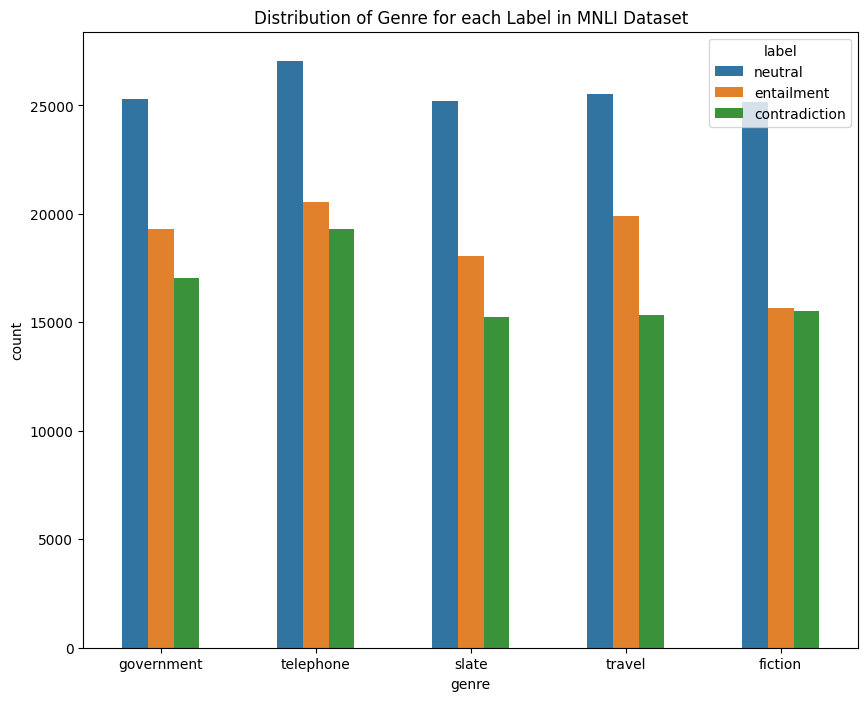

In [ ]:
# plot the genre distribution

plt.figure(figsize=(10,8))
sns.countplot(data=artefact_inst_df, x='genre', hue='label', width=0.5)
plt.title('Distribution of Genre for each Label in MNLI Dataset')
plt.show()


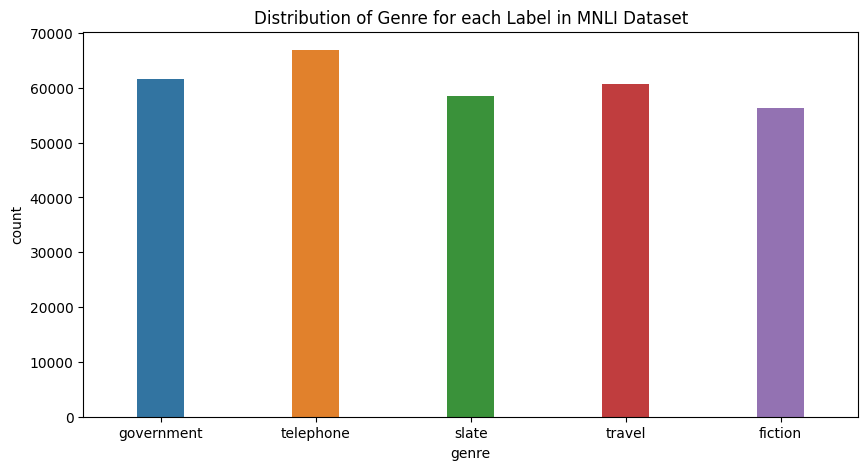

In [ ]:
# plot the genre counts

plt.figure(figsize=(10,5))
sns.countplot(data=artefact_inst_df, x='genre', width=0.3)
plt.title('Distribution of Genre for each Label in MNLI Dataset')
plt.show()

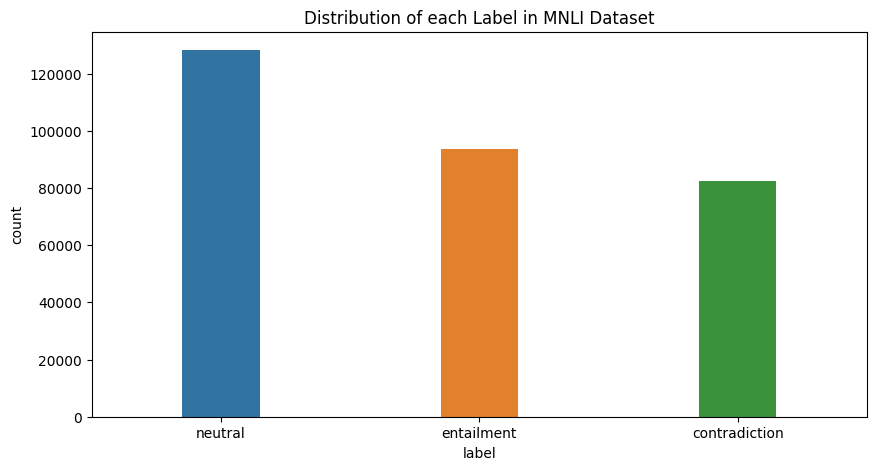

In [ ]:
# plot the label counts

plt.figure(figsize=(10,5))
sns.countplot(data=artefact_inst_df, x='label', width=0.3)
plt.title('Distribution of each Label in MNLI Dataset')
plt.show()

# Artefact detection Using PMI


Excerpt from the paper : "Annotation Artefacts in Natural Language Inference Data"

"To see whether the use of certain words is indica- tive of the inference class, we compute the point- wise mutual information (PMI) between each word and class in the training set:
PMI(word, class) = log p(word, class) p(word, ·)p(·, class)
We apply add-100 smoothing to the raw statistics; the aggressive smoothing emphasizes word-class correlations that are highly discriminative. Table 4 shows the top words affiliated with each class by PMI, along with the proportion of training sen- tences in each class containing each word."


In [ ]:
# Create a copy of the original DataFrame
smoothed_token_df = token_df.copy()

# Add-100 smoothing to the counts for each label for each token
for label in labels:
    smoothed_token_df[f"{label}_count"] += 100

# Recalculate total counts after smoothing
smoothed_token_df["total_count"] = smoothed_token_df[[f"{label}_count" for label in labels]].sum(axis=1)
total_token_count = smoothed_token_df["total_count"].sum()
total_label_counts = {label: smoothed_token_df[f"{label}_count"].sum() for label in labels}

# Calculate the joint and independent probabilities, and then the PMI for each label
for label in labels:
    # Calculate the joint probability p(x, y) = p(word, class)
    smoothed_token_df[f"{label}_joint_prob"] = smoothed_token_df[f"{label}_count"] / total_token_count

    # Calculate the independent probabilities p(x) and p(y)
    smoothed_token_df[f"{label}_token_prob"] = smoothed_token_df["total_count"] / total_token_count
    smoothed_token_df[f"{label}_label_prob"] = total_label_counts[label] / total_token_count

    # Calculate the PMI
    smoothed_token_df[f"{label}_pmi"] = np.log(smoothed_token_df[f"{label}_joint_prob"] / (smoothed_token_df[f"{label}_token_prob"] * smoothed_token_df[f"{label}_label_prob"]))


In [ ]:
smoothed_token_df

,token,total_count,neutral_count,neutral_prob,entailment_count,entailment_prob,contradiction_count,contradiction_prob,neutral_z_stat,entailment_z_stat,...,neutral_label_prob,neutral_pmi,entailment_joint_prob,entailment_token_prob,entailment_label_prob,entailment_pmi,contradiction_joint_prob,contradiction_token_prob,contradiction_label_prob,contradiction_pmi
0,product,829,286,0.351607,279,0.338374,264,0.310019,0.891569,0.245950,...,0.337583,0.021714,0.000012,0.000037,0.332743,0.011375,0.000012,0.000037,0.329673,-0.034618
1,and,59557,20078,0.337142,20696,0.347571,18783,0.315288,1.966545,7.352031,...,0.337583,-0.001366,0.000916,0.002636,0.332743,0.043390,0.000831,0.002636,0.329673,-0.044328
2,geography,334,111,0.323529,115,0.441176,108,0.235294,-0.121268,1.333946,...,0.337583,-0.015668,0.000005,0.000015,0.332743,0.034175,0.000005,0.000015,0.329673,-0.019356
3,are,41260,14916,0.361719,13469,0.326392,12875,0.311890,12.186570,-2.980259,...,0.337583,0.068484,0.000596,0.001826,0.332743,-0.019119,0.000570,0.001826,0.329673,-0.054953
4,what,8618,2806,0.325319,3230,0.376292,2582,0.298389,-1.550621,8.311326,...,0.337583,-0.036150,0.000143,0.000381,0.332743,0.119013,0.000114,0.000381,0.329673,-0.095635
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
62252,wranglerloving,301,101,1.000000,100,0.000000,100,0.000000,1.414214,-0.707107,...,0.337583,-0.006047,0.000004,0.000013,0.332743,-0.001557,0.000004,0.000013,0.329673,0.007713
62253,reasserting,301,101,1.000000,100,0.000000,100,0.000000,1.414214,-0.707107,...,0.337583,-0.006047,0.000004,0.000013,0.332743,-0.001557,0.000004,0.000013,0.329673,0.007713
62254,léon,301,100,0.000000,100,0.000000,101,1.000000,-0.707107,-0.707107,...,0.337583,-0.015997,0.000004,0.000013,0.332743,-0.001557,0.000004,0.000013,0.329673,0.017664
62255,barb,301,100,0.000000,101,1.000000,100,0.000000,-0.707107,1.414214,...,0.337583,-0.015997,0.000004,0.000013,0.332743,0.008394,0.000004,0.000013,0.329673,0.007713


In [ ]:
# Define a PMI threshold. In this case, we will set it to the 95th percentile of the PMI values.
pmi_thresholds = {label: smoothed_token_df[f"{label}_pmi"].quantile(0.95) for label in labels}


In [ ]:
pmi_thresholds

{'neutral': 0.01959135306725329,
 'entailment': 0.02774666045352205,
 'contradiction': 0.024199316211487517}

In [ ]:
# Create an empty DataFrame to store the artefacts
pmi_artefacts_df = pd.DataFrame()
label_artefacts_df = pd.DataFrame()

# Loop over each label
for label in labels:
    # Calculate the PMI threshold for the current label
    pmi_threshold = pmi_thresholds[label]

    # Identify the artefacts for the current label
    label_artefacts_df = smoothed_token_df[smoothed_token_df[f"{label}_pmi"] > pmi_threshold]
    label_artefacts_df['correlated_to'] = label

    # Add the artefacts for the current label to the overall artefacts DataFrame
    pmi_artefacts_df = pd.concat([pmi_artefacts_df, label_artefacts_df])

# Remove duplicates from the overall artefacts DataFrame
pmi_artefacts_df = pmi_artefacts_df.drop_duplicates()


<ipython-input-42-e5e1e93cbd59>:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-42-e5e1e93cbd59>:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-42-e5e1e93cbd59>:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
pmi_artefacts_df[pmi_artefacts_df['token']=='rescind']

,token,total_count,neutral_count,neutral_prob,entailment_count,entailment_prob,contradiction_count,contradiction_prob,neutral_z_stat,entailment_z_stat,...,neutral_label_prob,neutral_pmi,entailment_joint_prob,entailment_token_prob,entailment_label_prob,entailment_pmi,contradiction_joint_prob,contradiction_token_prob,contradiction_label_prob,contradiction_pmi


In [ ]:
pmi_artefacts_df

,token,total_count,neutral_count,neutral_prob,entailment_count,entailment_prob,contradiction_count,contradiction_prob,neutral_z_stat,entailment_z_stat,...,neutral_pmi,entailment_joint_prob,entailment_token_prob,entailment_label_prob,entailment_pmi,contradiction_joint_prob,contradiction_token_prob,contradiction_label_prob,contradiction_pmi,label
0,product,829,286,0.351607,279,0.338374,264,0.310019,0.891569,0.245950,...,0.021714,0.000012,0.000037,0.332743,0.011375,0.000012,0.000037,0.329673,-0.034618,neutral
3,are,41260,14916,0.361719,13469,0.326392,12875,0.311890,12.186570,-2.980259,...,0.068484,0.000596,0.001826,0.332743,-0.019119,0.000570,0.001826,0.329673,-0.054953,neutral
5,make,4980,2066,0.420085,1531,0.305769,1383,0.274145,12.589526,-4.000120,...,0.206127,0.000068,0.000220,0.332743,-0.079125,0.000061,0.000220,0.329673,-0.171521,neutral
6,cream,421,153,0.438017,132,0.264463,136,0.297521,2.442733,-1.607061,...,0.073748,0.000006,0.000019,0.332743,-0.059447,0.000006,0.000019,0.329673,-0.020324,neutral
8,work,5683,2136,0.378228,1816,0.318781,1731,0.302991,6.987323,-2.264856,...,0.107398,0.000080,0.000252,0.332743,-0.040460,0.000077,0.000252,0.329673,-0.079126,neutral
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55789,homely,304,100,0.000000,100,0.000000,104,1.000000,-1.414214,-1.414214,...,-0.025915,0.000004,0.000013,0.332743,-0.011474,0.000005,0.000013,0.329673,0.037017,contradiction
56429,conrads,304,101,0.250000,100,0.000000,103,0.750000,-0.353553,-1.414214,...,-0.015964,0.000004,0.000013,0.332743,-0.011474,0.000005,0.000013,0.329673,0.027355,contradiction
57370,supposing,303,100,0.000000,100,0.000000,103,1.000000,-1.224745,-1.224745,...,-0.022620,0.000004,0.000013,0.332743,-0.008179,0.000005,0.000013,0.329673,0.030650,contradiction
57581,mend,303,100,0.000000,100,0.000000,103,1.000000,-1.224745,-1.224745,...,-0.022620,0.000004,0.000013,0.332743,-0.008179,0.000005,0.000013,0.329673,0.030650,contradiction


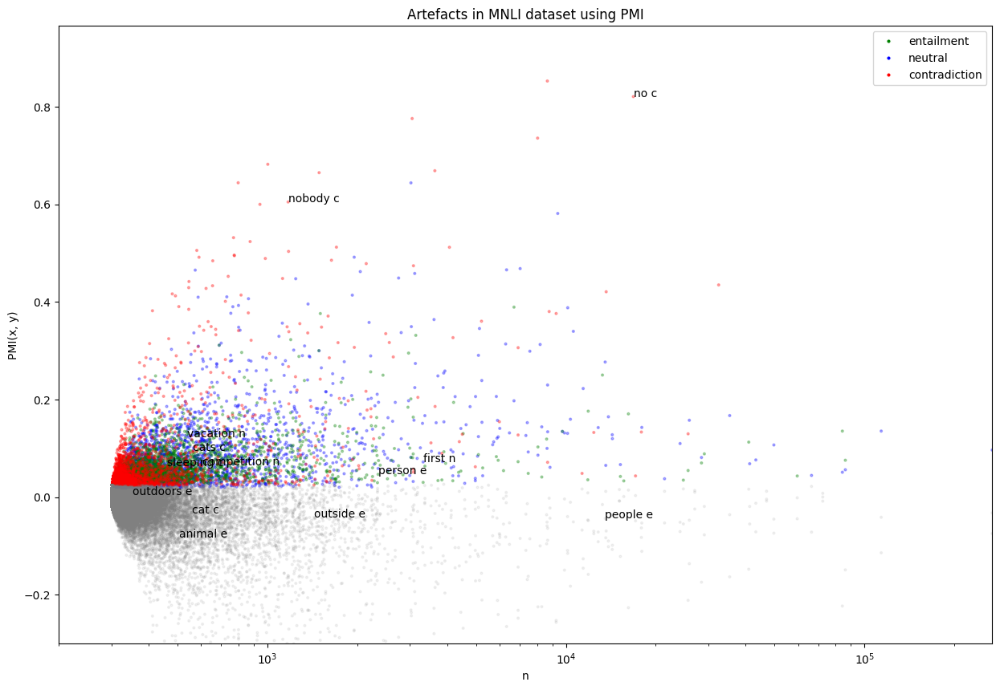

In [ ]:
# Define the figure and axes for the plot
fig, ax = plt.subplots(figsize=(15,10))

# Define a dictionary of colors for each label
colors = {'entailment': 'g', 'neutral': 'b', 'contradiction': 'r', 'grey': 'grey'}

# Define a dictionary of words to annotate in the plot for each label
token_label_annotate_dict = {
    'contradiction': ['nobody', 'cats', 'cat', 'no', 'sleeping'],
    'neutral': ['vacation', 'first', 'competition'],
    'entailment': ['outdoors', 'animal', 'outside', 'person', 'people']
}

# Plot the PMI for each token and label
for label in labels:
    # Create a condition series to find which points are above the threshold
    is_above_threshold = smoothed_token_df[f'{label}_pmi'] > pmi_thresholds[label]

    # Create a color and alpha series based on the condition series
    color_series = pd.Series(colors['grey'], index=smoothed_token_df.index)
    color_series[is_above_threshold] = colors[label]

    alpha_series = pd.Series(0.1, index=smoothed_token_df.index)
    alpha_series[is_above_threshold] = 0.3

    # Plot the points for this label
    ax.scatter(smoothed_token_df['total_count'], smoothed_token_df[f'{label}_pmi'], c=color_series, alpha=alpha_series, s=4)

    # Add annotations for selected words
    for token in set(token_label_annotate_dict[label]) & set(smoothed_token_df['token']):
        x = smoothed_token_df.loc[smoothed_token_df['token'] == token, 'total_count'].values[0]
        y = smoothed_token_df.loc[smoothed_token_df['token'] == token, f'{label}_pmi'].values[0]
        ax.annotate(f'{token} {label[0]}', (x, y))

# Adjust x-axis to be logarithmic and limit its range
ax.set_xscale('log')
ax.set_xlim([10**2.3, max(smoothed_token_df['total_count'])])

ax.set_ylim([-0.3, ax.get_ylim()[1]])

# Hide the first x-axis label
# ax.xaxis.get_major_ticks()[0].label1.set_visible(False)

# Set the labels for the x and y axes, and the title for the plot
ax.set_xlabel('n')
ax.set_ylabel('PMI(x, y)')
ax.set_title('Artefacts in MNLI dataset using PMI')

# Create custom legend
legend_elements = [Line2D([0], [0], marker='o', color='w', label=label,
                          markerfacecolor=color, markersize=4) for label, color in colors.items() if label != 'grey']
ax.legend(handles=legend_elements, loc='upper right')

# Display the plot
plt.show()


In [ ]:
# Create an interactive scatter plot using Plotly

# Define a new figure
fig = go.Figure()

# Define a dictionary of colors for each label
colors = {'entailment': 'green', 'neutral': 'blue', 'contradiction': 'red', 'grey': 'grey'}

# Plot the PMI for each token and label
for label in labels:
    # Get the DataFrame for the current label
    data_label = smoothed_token_df

    # Determine which points are above the threshold
    is_above_threshold = data_label[f'{label}_pmi'] > pmi_thresholds[label]

    # Add scatter plots for points above and below the threshold
    for condition, color in zip([is_above_threshold, ~is_above_threshold], [colors[label], 'grey']):
        token = data_label[condition]['token']
        text = [f"Label: {label}<br>Token: {t}" for t in token]
        fig.add_trace(go.Scatter(
            x = data_label[condition]['total_count'],
            y = data_label[condition][f'{label}_pmi'],
            mode = 'markers',
            name = label if color != 'grey' else None,
            marker = dict(
                color = color,
                size = 4
            ),
            text = text,
            hovertemplate = "%{text}<br>Occurrences: %{x}<br>PMI: %{y}<extra></extra>"
        ))

# Set the scale of the x-axis to logarithmic and limit its range
fig.update_xaxes(type='log', range=[2.3, np.log10(max(token_df['total_count']))])

# Set the labels for the x and y axes, and the title for the plot
fig.update_layout(
    xaxis_title='n',
    yaxis_title='PMI(x, y)',
    title='Artefacts in MNLI dataset'
)

# Display the plot
fig.show()


In [ ]:
fig.write_html('mnli_artefacts_pmi_interactive_chart.html')

Analysis of Top N words associated with each label in the NLI data

In [ ]:
# Number of top words to display
n_top_words = 10

# For each label, display the top n words by PMI
for label in labels:
    top_words_df = smoothed_token_df.nlargest(n_top_words, f"{label}_pmi")[["token", f"{label}_count"]]
    # percentage of the token that occurs in the sentences of a particular label
    top_words_df[f"{label}_percentage"] = top_words_df[f"{label}_count"] / total_label_counts[label] * 100
    print(f"\nTop {n_top_words} words affiliated with '{label}' by PMI:")
    print(top_words_df.to_string(index=False))


# The top words match with the table 4 presented in the paper but the percentages are different. This might be due to a calculation error?



Top 10 words affiliated with 'neutral' by PMI:
   token  neutral_count  neutral_percentage
    also           1945            0.025502
 because           5668            0.074316
 popular           1078            0.014134
    many           3788            0.049666
    most           3403            0.044618
 besides            308            0.004038
     due           1097            0.014383
  better           1663            0.021804
  wanted           1455            0.019077
tourists            657            0.008614

Top 10 words affiliated with 'entailment' by PMI:
    token  entailment_count  entailment_percentage
     some              3290               0.043764
      yes               729               0.009697
something              1456               0.019368
sometimes               550               0.007316
  various               313               0.004164
   called               668               0.008886
    aware               367               0.004882
      may

In [ ]:
# Assuming 'tokens' is a list in each row
mnli_train_exploded = mnli_train.explode('tokens')
pmi_artefacts_df_exploded = pmi_artefacts_df.explode('label')

# Rename column 'correlated_to' to 'label' for the merge operation
# pmi_artefacts_df_exploded.rename(columns={'correlated_to': 'label'}, inplace=True)

# Merge dataframes on 'token' and 'label'
pmi_artefact_merged_df = pd.merge(mnli_train_exploded, pmi_artefacts_df_exploded, left_on=['tokens', 'label'], right_on=['token', 'label'])

# Keep only the needed columns and rename 'token' to 'pmi_artefact'
pmi_artefact_inst_df = pmi_artefact_merged_df[["pairID",'tokens', 'label', 'genre', 'hypothesis', 'premise']].rename(columns={'tokens': 'pmi_artefact'})

#drop duplicates
pmi_artefact_inst_df = pmi_artefact_inst_df.drop_duplicates(subset=['hypothesis', 'premise'])

In [ ]:
pmi_artefact_inst_df

,pairID,pmi_artefact,label,genre,hypothesis,premise
0,31193n,product,neutral,government,Product and geography are what make cream skim...,Conceptually cream skimming has two basic dime...
1,84809n,product,neutral,government,The objectives and statuses of an acquisition ...,"Different metrics may be useful for an audit, ..."
2,114824n,product,neutral,government,The server's name or product bar code number w...,The information had to include specific identi...
3,42101n,product,neutral,government,Moulton worked on the Comprehensive revision o...,For more information on the recent NIPA defini...
4,7545n,product,neutral,slate,"The animation, showing a kitchen product being...",It featured an animation sequence that showed ...
...,...,...,...,...,...,...
1543667,116690c,demolish,contradiction,travel,Japan is set to demolish the Odori Promenade i...,One of the most attractive postwar urban innov...
1543683,47637c,underestimate,contradiction,fiction,Intelligent people often underestimate his abi...,Only a fool underestimates his capabilities.
1543685,63977c,underestimate,contradiction,fiction,"You underestimate my manly charms, murmured To...","You overrate my manly charms, murmured Tommy."
1543729,94290c,troll,contradiction,fiction,She was a troll.,She was a goddess.


In [ ]:
token = "aware"
print("Artefact")
print(pmi_artefact_inst_df[pmi_artefact_inst_df['pmi_artefact']==token]['label'].value_counts())
print("Normal")
print(mnli_train_exploded[mnli_train_exploded['tokens']==token]['label'].value_counts())

Artefact
entailment    9
Name: label, dtype: int64
Normal
entailment       267
neutral          136
contradiction    117
Name: label, dtype: int64


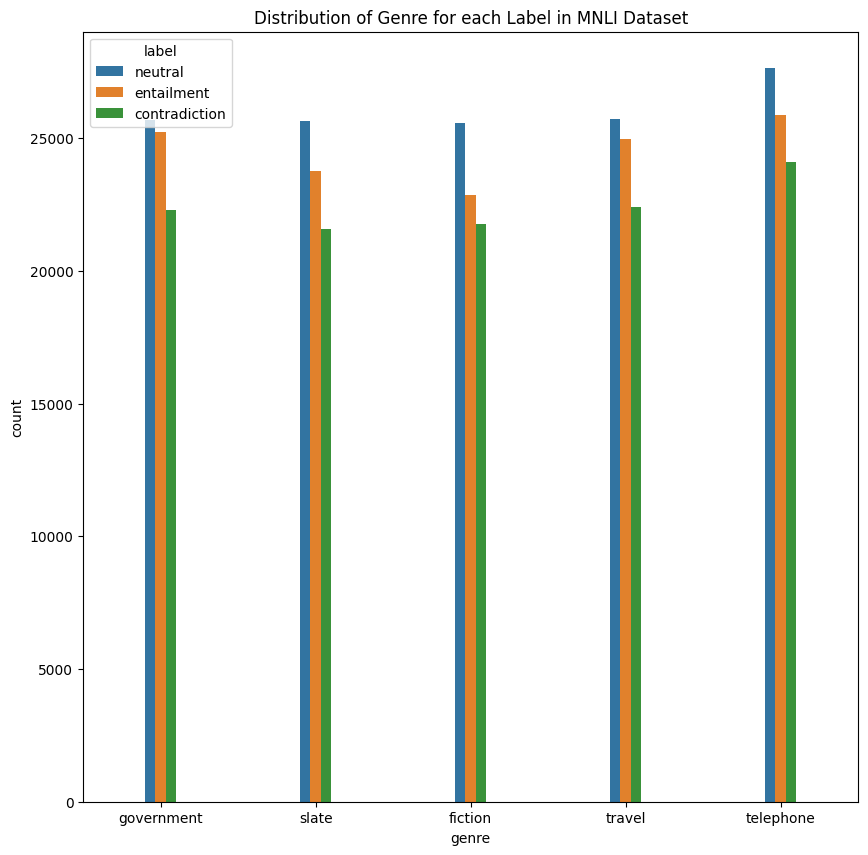

In [ ]:
# plot the genre distribution

plt.figure(figsize=(10,10))
sns.countplot(data=pmi_artefact_inst_df, x='genre', hue='label', width=0.2)
plt.title('Distribution of Genre for each Label in MNLI Dataset')
plt.show()

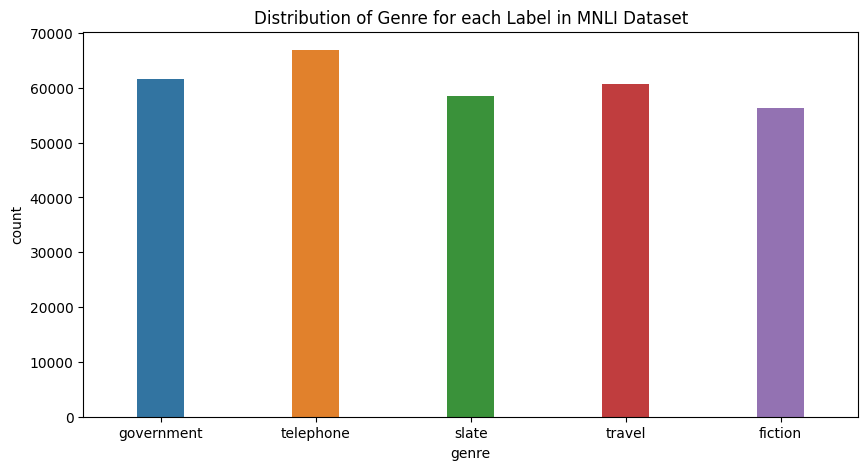

In [ ]:
# plot the genre counts

plt.figure(figsize=(10,5))
sns.countplot(data=artefact_inst_df, x='genre', width=0.3)
plt.title('Distribution of Genre for each Label in MNLI Dataset')
plt.show()

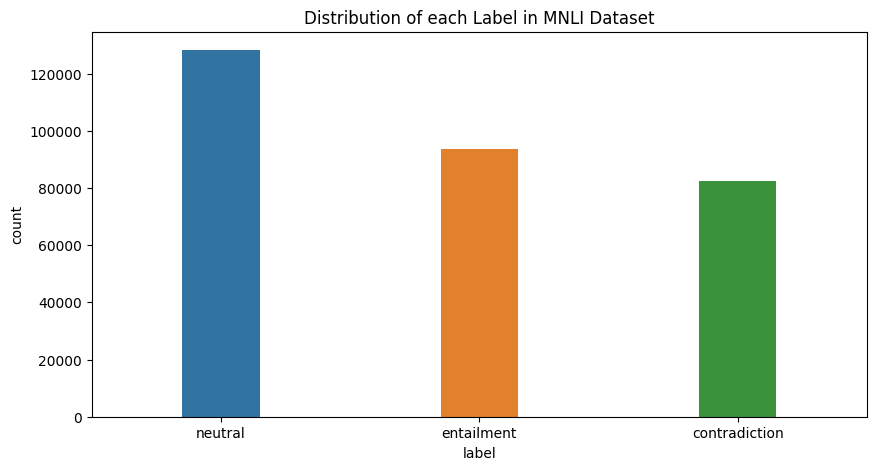

In [ ]:
# plot the label counts

plt.figure(figsize=(10,5))
sns.countplot(data=artefact_inst_df, x='label', width=0.3)
plt.title('Distribution of each Label in MNLI Dataset')
plt.show()

# Sentence Length as an Artefact

In [ ]:
# mnli_train dataframe contains the hypothesis sentences and the labels
mnli_train.head()

,pairID,premise,hypothesis,genre,label,tokens,artefact
0,31193n,Conceptually cream skimming has two basic dime...,Product and geography are what make cream skim...,government,neutral,"[product, and, geography, are, what, make, cre...",are
1,101457e,you know during the season and i guess at at y...,You lose the things to the following level if ...,telephone,entailment,"[you, lose, the, things, to, the, following, l...",if
2,134793e,One of our number will carry out your instruct...,A member of my team will execute your orders w...,fiction,entailment,"[a, member, of, my, team, will, execute, your,...",a
3,37397e,How do you know? All this is their information...,This information belongs to them.,fiction,entailment,"[this, information, belongs, to, them]",None
4,50563n,yeah i tell you what though if you go price so...,The tennis shoes have a range of prices.,telephone,neutral,"[the, tennis, shoes, have, a, range, of, prices]",the


In [ ]:
# create a new dataframe with the hypothesis sentences and the labels
hypothesis_length_df = mnli_train[['hypothesis', 'label', 'genre']]

In [ ]:
hypothesis_length_df

,hypothesis,label,genre
0,Product and geography are what make cream skim...,neutral,government
1,You lose the things to the following level if ...,entailment,telephone
2,A member of my team will execute your orders w...,entailment,fiction
3,This information belongs to them.,entailment,fiction
4,The tennis shoes have a range of prices.,neutral,telephone
...,...,...,...
392697,California cannot do any better.,contradiction,government
392698,So many of the original buildings had been rep...,neutral,travel
392699,The tradition of houseboats originated while t...,entailment,travel
392700,The obituaries were beautiful and written in k...,neutral,slate


In [ ]:
# split the hypothesis sentences into tokens and calculate the length of each sentence again
# because the preprocessing steps in the paper are not clear

hypothesis_length_df['tokens'] = hypothesis_length_df['hypothesis'].apply(lambda x: x.split())

hypothesis_length_df['length'] = hypothesis_length_df['tokens'].apply(lambda x: len(x))

<ipython-input-124-bea729cf6c17>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-124-bea729cf6c17>:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
hypothesis_length_df

,hypothesis,label,genre,tokens,length
0,Product and geography are what make cream skim...,neutral,government,"[Product, and, geography, are, what, make, cre...",9
1,You lose the things to the following level if ...,entailment,telephone,"[You, lose, the, things, to, the, following, l...",12
2,A member of my team will execute your orders w...,entailment,fiction,"[A, member, of, my, team, will, execute, your,...",12
3,This information belongs to them.,entailment,fiction,"[This, information, belongs, to, them.]",5
4,The tennis shoes have a range of prices.,neutral,telephone,"[The, tennis, shoes, have, a, range, of, prices.]",8
...,...,...,...,...,...
392697,California cannot do any better.,contradiction,government,"[California, cannot, do, any, better.]",5
392698,So many of the original buildings had been rep...,neutral,travel,"[So, many, of, the, original, buildings, had, ...",12
392699,The tradition of houseboats originated while t...,entailment,travel,"[The, tradition, of, houseboats, originated, w...",13
392700,The obituaries were beautiful and written in k...,neutral,slate,"[The, obituaries, were, beautiful, and, writte...",15


In [ ]:
# group the dataframe by the labels
grouped = hypothesis_length_df.groupby("label")

# Initialize a list to hold the length distributions
length_distributions_list = []

for label, group_df in grouped:
    # Calculate the length distribution for this group
    length_distribution = group_df["length"].value_counts(normalize=True).rename("probability").reset_index()
    length_distribution["label"] = label  # Add the label column

    # Add this distribution to the list
    length_distributions_list.append(length_distribution)

# Concatenate all the distributions into one DataFrame
length_distributions = pd.concat(length_distributions_list)


In [ ]:
length_distributions.rename(columns={'index':'length'}, inplace=True)

In [ ]:
length_distributions

,length,probability,label
0,8,0.118187,contradiction
1,9,0.112549,contradiction
2,7,0.103260,contradiction
3,10,0.098661,contradiction
4,6,0.088302,contradiction
...,...,...,...
53,52,0.000008,neutral
54,56,0.000008,neutral
55,53,0.000008,neutral
56,51,0.000008,neutral


In [ ]:
length_distributions = length_distributions.sort_values(by=['length'])
length_distributions

,length,probability,label
24,1,0.001642,entailment
21,1,0.001528,contradiction
28,1,0.000604,neutral
16,2,0.007647,contradiction
17,2,0.007930,entailment
...,...,...,...
57,58,0.000008,neutral
51,58,0.000008,entailment
52,60,0.000008,entailment
53,61,0.000008,entailment


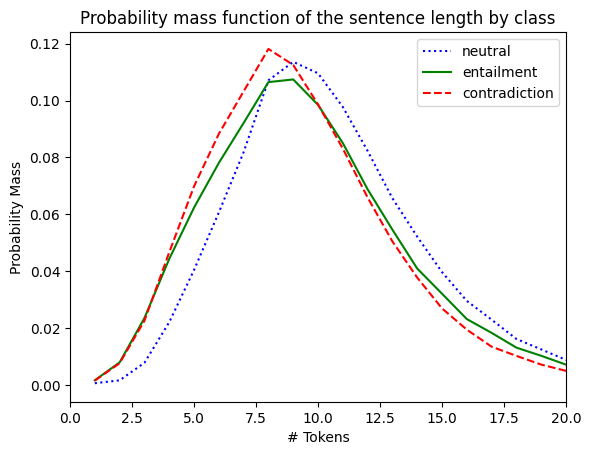

In [ ]:
# Initialize the plot
fig, ax = plt.subplots()

# give different line styles to each label
linestyle = {
    "entailment": "-",
    "contradiction": "dashed",
    'neutral': 'dotted'
}

# provide different colors to each label
colors = {
    "entailment": "g",
    "contradiction": "r",
    'neutral': "b",
}


# For each label, plot the probability mass function
for label in labels:
    data_label = length_distributions[length_distributions["label"] == label]
    ax.plot(data_label["length"], data_label["probability"],
            label=label, linestyle=linestyle[label], color=colors[label])

# Set the labels and title for the plot
ax.set_xlabel("# Tokens")
ax.set_ylabel("Probability Mass")
ax.set_title("Probability mass function of the sentence length by class")
ax.legend()

ax.set_xlim([0, 20])

# Display the plot
plt.show()


In [ ]:
print(f"Mean length of the hypothesis sentences for label Contradiction: {hypothesis_length_df[hypothesis_length_df['label']=='contradiction']['length'].mean()}")
print(f"Mean length of the hypothesis sentences for label Entailment: {hypothesis_length_df[hypothesis_length_df['label']=='entailment']['length'].mean()}")
print(f"Mean length of the hypothesis sentences for label Neutral: {hypothesis_length_df[hypothesis_length_df['label']=='neutral']['length'].mean()}")
print(f"Median length of the hypothesis sentences for label Contradiction: {hypothesis_length_df[hypothesis_length_df['label']=='contradiction']['length'].median()}")
print(f"Median length of the hypothesis sentences for label Entailment: {hypothesis_length_df[hypothesis_length_df['label']=='entailment']['length'].median()}")
print(f"Median length of the hypothesis sentences for label Neutral: {hypothesis_length_df[hypothesis_length_df['label']=='neutral']['length'].median()}")

Mean length of the hypothesis sentences for label Contradiction: 9.340328334721129
Mean length of the hypothesis sentences for label Entailment: 9.870480293967104
Mean length of the hypothesis sentences for label Neutral: 10.705393430099312
Median length of the hypothesis sentences for label Contradiction: 9.0
Median length of the hypothesis sentences for label Entailment: 9.0
Median length of the hypothesis sentences for label Neutral: 10.0


In [ ]:
hypothesis_length_df['length'].describe()

count    392702.000000
mean          9.972063
std           4.246692
min           1.000000
25%           7.000000
50%           9.000000
75%          12.000000
max          69.000000
Name: length, dtype: float64

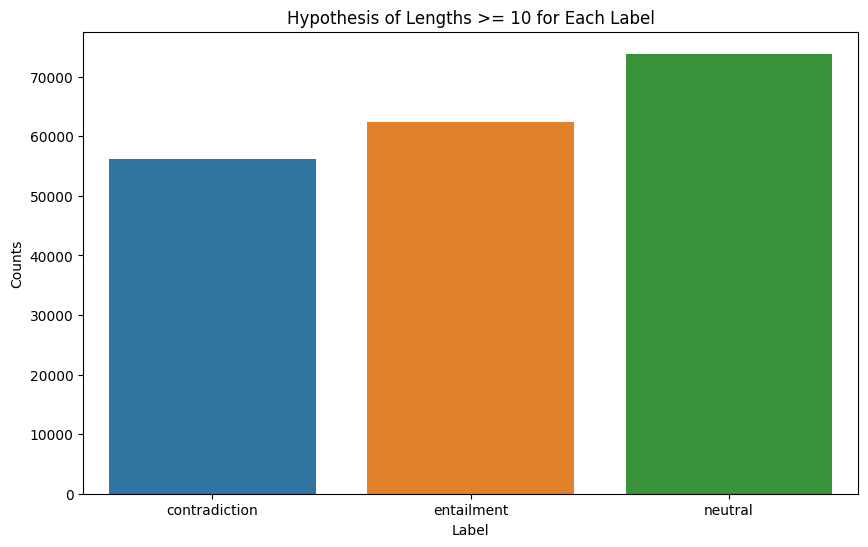

In [ ]:
threshold = 10

filtered_df = hypothesis_length_df[hypothesis_length_df['length'] >= threshold]

# Then, group by 'label' and count the number of 'length' entries for each 'label'
grouped_counts = filtered_df.groupby('label')['length'].count()

# Plot the counts
plt.figure(figsize=(10, 6))
sns.barplot(x=grouped_counts.index, y=grouped_counts.values)
plt.title(f'Hypothesis of Lengths >= {threshold} for Each Label')
plt.xlabel('Label')
plt.ylabel('Counts')
plt.show()

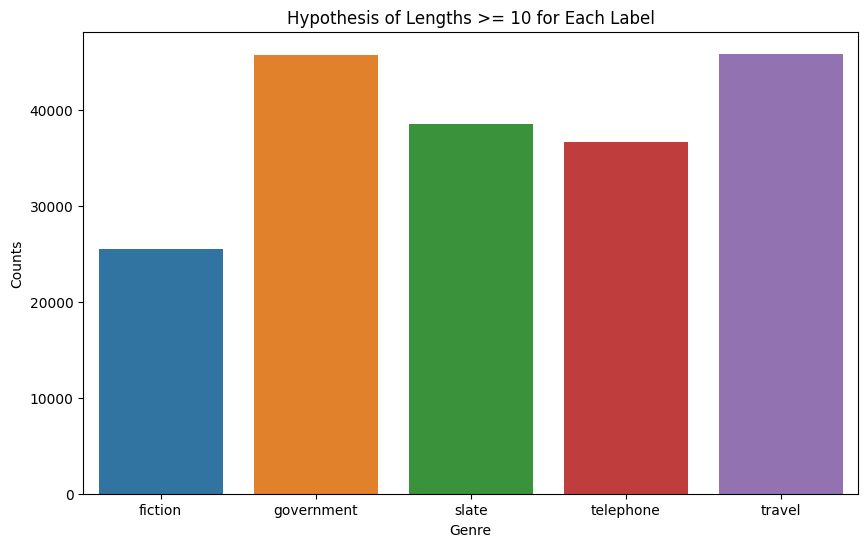

In [ ]:
# Then, group by 'label' and count the number of 'length' entries for each 'label'
genre_grouped_counts = filtered_df.groupby('genre')['length'].count()

# Plot the counts
plt.figure(figsize=(10, 6))
sns.barplot(x=genre_grouped_counts.index, y=genre_grouped_counts.values)
plt.title(f'Hypothesis of Lengths >= {threshold} for Each Label')
plt.xlabel('Genre')
plt.ylabel('Counts')
plt.show()

## Word Overlap Bias

In [ ]:
def calculate_overlap(premise, hypothesis):
    """
    This function takes in two sentences as arguments (the premise and the hypothesis), tokenizes them,
    and calculates the count of words that overlap between them if the overlap is high (above the threshold).
    The threshold is defined as a ratio of the total words in both sentences.
    """

    # Tokenize the sentences
    premise_tokens = nltk.word_tokenize(premise.lower())
    hypothesis_tokens = nltk.word_tokenize(hypothesis.lower())

    # Count the words in each sentence
    premise_counter = Counter(premise_tokens)
    hypothesis_counter = Counter(hypothesis_tokens)

    # Calculate the overlap using the intersection of the two Counters
    overlap_counter = premise_counter & hypothesis_counter
    overlap = sum(overlap_counter.values())

    return overlap

def detect_word_overlap_bias(df):
    """
    This function takes in a dataframe with 'premise', 'hypothesis', and 'label' columns,
    calculates the number of overlapping words for each row and adds this as a new 'overlap' column,
    then calculates the average overlap for 'entailment' cases and for 'non-entailment' cases,
    and compares the two.
    It also counts the number of instances in the 'entailment' and 'non-entailment' cases
    where the overlap is above a given threshold.
    """

    # Calculate overlap for each row and add it as a new 'overlap' column
    df['overlap'] = df.apply(lambda row: calculate_overlap(row['premise'], row['hypothesis']), axis=1)

    return df

In [ ]:
wob_df = detect_word_overlap_bias(mnli_train)

In [ ]:
wob_df

,pairID,premise,hypothesis,genre,label,tokens,artefact,overlap
0,31193n,Conceptually cream skimming has two basic dime...,Product and geography are what make cream skim...,government,neutral,"[product, and, geography, are, what, make, cre...",are,6
1,101457e,you know during the season and i guess at at y...,You lose the things to the following level if ...,telephone,entailment,"[you, lose, the, things, to, the, following, l...",if,9
2,134793e,One of our number will carry out your instruct...,A member of my team will execute your orders w...,fiction,entailment,"[a, member, of, my, team, will, execute, your,...",a,4
3,37397e,How do you know? All this is their information...,This information belongs to them.,fiction,entailment,"[this, information, belongs, to, them]",None,3
4,50563n,yeah i tell you what though if you go price so...,The tennis shoes have a range of prices.,telephone,neutral,"[the, tennis, shoes, have, a, range, of, prices]",the,5
...,...,...,...,...,...,...,...,...
392697,30418c,"Clearly, California can - and must - do better.",California cannot do any better.,government,contradiction,"[california, cannot, do, any, better]",any,5
392698,105454n,It was once regarded as the most beautiful str...,So many of the original buildings had been rep...,travel,neutral,"[so, many, of, the, original, buildings, had, ...",the,9
392699,13960e,Houseboats are a beautifully preserved traditi...,The tradition of houseboats originated while t...,travel,entailment,"[the, tradition, of, houseboats, originated, w...",of,8
392700,114061n,Obituaries fondly recalled his on-air debates ...,The obituaries were beautiful and written in k...,slate,neutral,"[the, obituaries, were, beautiful, and, writte...",the,4


In [ ]:
wob_df['overlap'].describe()

count    392702.000000
mean          5.822766
std           3.567834
min           0.000000
25%           3.000000
50%           5.000000
75%           8.000000
max          64.000000
Name: overlap, dtype: float64

In [ ]:
genre_wob_groups = wob_df.groupby('genre')

In [ ]:
entailment_wob_df = wob_df[wob_df['label'] == 'entailment']
non_entailment_wob_df = wob_df[(wob_df['label'] == 'contradiction')]
neutral_wob_df = wob_df[(wob_df['label'] == 'neutral')]

# print number of instances
print(f'Number of total cases: {wob_df.shape[0]}')
print(f'Number of entailment cases: {entailment_wob_df.shape[0]}')
print(f'Number of non-entailment cases: {non_entailment_wob_df.shape[0]}')
print(f'Number of neutral cases: {neutral_wob_df.shape[0]}')

Number of total cases: 392702
Number of entailment cases: 130899
Number of non-entailment cases: 130903
Number of neutral cases: 130900


In [ ]:
entailment_wob_df['overlap'].describe()

count    130899.000000
mean          7.050222
std           4.029157
min           0.000000
25%           4.000000
50%           6.000000
75%           9.000000
max          64.000000
Name: overlap, dtype: float64

In [ ]:
non_entailment_wob_df['overlap'].describe()

count    130903.000000
mean          5.247496
std           3.130727
min           0.000000
25%           3.000000
50%           5.000000
75%           7.000000
max          50.000000
Name: overlap, dtype: float64

In [ ]:
neutral_wob_df['overlap'].describe()

count    130900.000000
mean          5.170604
std           3.144858
min           0.000000
25%           3.000000
50%           5.000000
75%           7.000000
max          58.000000
Name: overlap, dtype: float64

The number of entailment cases with overlap above 20 is 1292
The number of non-entailment cases with overlap above 20 is 246
The number of neutral cases with overlap above 20 is 323


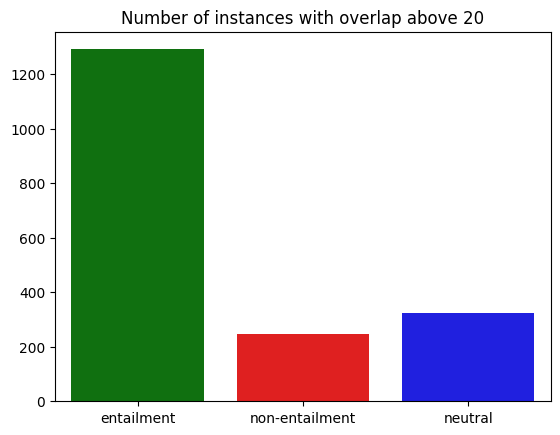

In [ ]:
ov_threshold = 20

n_overlap_entailment = entailment_wob_df[entailment_wob_df['overlap'] > ov_threshold]

n_overlap_contradiction = non_entailment_wob_df[non_entailment_wob_df['overlap'] > ov_threshold]

n_overlap_neutral = neutral_wob_df[neutral_wob_df['overlap'] > ov_threshold]


print(f"The number of entailment cases with overlap above {ov_threshold} is {n_overlap_entailment.shape[0]}")
print(f"The number of non-entailment cases with overlap above {ov_threshold} is {n_overlap_contradiction.shape[0]}")
print(f"The number of neutral cases with overlap above {ov_threshold} is {n_overlap_neutral.shape[0]}")

# Data
labels = ['entailment', 'non-entailment', "neutral"]
counts = [n_overlap_entailment.shape[0], n_overlap_contradiction.shape[0], n_overlap_neutral.shape[0]]

# Create the bar plot
sns.barplot(x=labels, y=counts, palette=['g', 'r', 'b'])
plt.title(f'Number of instances with overlap above {ov_threshold}')
plt.show()



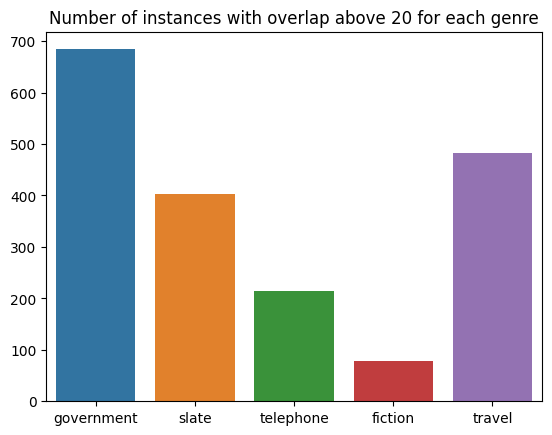

In [ ]:
genre = list(set(wob_df['genre'].to_list()))
genre_wob_counts = []
for gen in genre:
    genre_wob_df = genre_wob_groups.get_group(gen)
    genre_ovrlap_count = genre_wob_df[genre_wob_df['overlap'] > ov_threshold].shape[0]
    genre_wob_counts.append(genre_ovrlap_count)

# Create the bar plot
sns.barplot(x=genre, y=genre_wob_counts)
plt.title(f'Number of instances with overlap above {ov_threshold} for each genre')
plt.show()



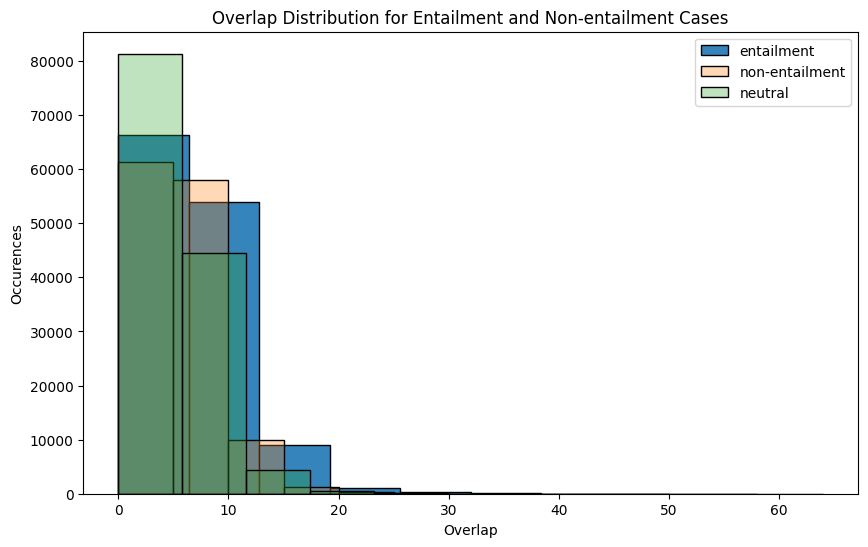

In [ ]:
plt.figure(figsize=(10, 6))

sns.histplot(entailment_wob_df['overlap'], label='entailment', bins=10,  alpha=0.9)
sns.histplot(non_entailment_wob_df['overlap'], label='non-entailment', bins=10, alpha=0.3)
sns.histplot(neutral_wob_df['overlap'], label='neutral', bins=10, alpha=0.3)


plt.title('Overlap Distribution for Entailment and Non-entailment Cases')
plt.xlabel('Overlap')
plt.ylabel('Occurences')
plt.legend(loc='upper right')

plt.show()

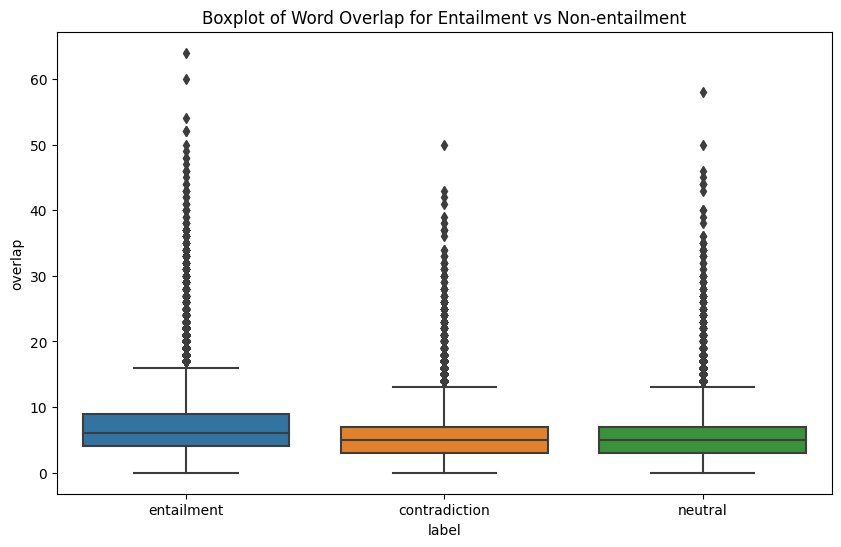

In [ ]:
# Combine the dataframes into one for easier plotting
combined_df = pd.concat([entailment_wob_df, non_entailment_wob_df, neutral_wob_df])

# Create a boxplot
plt.figure(figsize=(10, 6))
sns.boxplot(x='label', y='overlap', data=combined_df)
plt.title('Boxplot of Word Overlap for each labels')
plt.show()


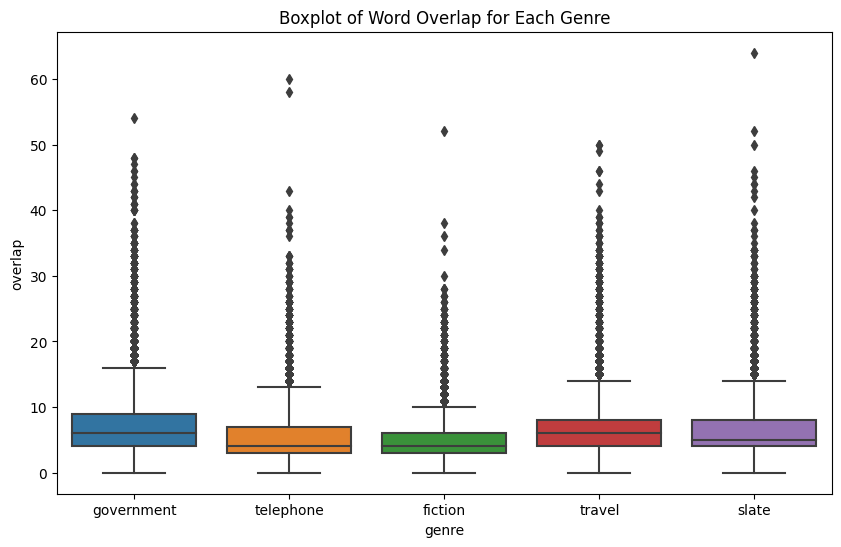

In [ ]:
# Create a boxplot
plt.figure(figsize=(10, 6))
sns.boxplot(x='genre', y='overlap', data=wob_df)
plt.title('Boxplot of Word Overlap for Each Genre')
plt.show()


## Contradiction Word Bias

In [ ]:
# Load the MNLI dataset
cwb_df = mnli_train[['premise','hypothesis','label', 'genre']]

# Load a SpaCy model and disable unneeded components
nlp = spacy.load('en_core_web_sm', disable=['tagger', 'ner'])

# List of negation words
negation_words = ["not", "no", "n't", "none", "neither", "never", "nobody", "nothing", "nowhere", "hardly", "scarcely", "barely", "rarely", "seldom"]

# Function to count the number of negations in a sentence
def extract_negations(doc):
    return [token.text for token in doc if token.text.lower() in negation_words]

# Use the pipe method to process the texts in batches
docs = list(nlp.pipe(cwb_df['hypothesis']))

# Apply the function to each Doc object
cwb_df['negations'] = [extract_negations(doc) for doc in docs]
# create a new column to store the number of negations in each sentence
cwb_df['negation_count'] = cwb_df['negations'].apply(lambda x: len(x))
# Create the contains_negation column
cwb_df['contains_negation'] = cwb_df['negation_count'] > 0


/usr/local/lib/python3.10/dist-packages/spacy/pipeline/lemmatizer.py:211: UserWarning:

[W108] The rule-based lemmatizer did not find POS annotation for one or more tokens. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.

<ipython-input-151-465cd56faecd>:18: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-151-465cd56faecd>:20: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-151-465cd56faecd>:22: SettingWit

In [ ]:
# calculate the top negation words for each label
labels = cwb_df['label'].unique().tolist()
for label in labels:
    top_words_df = cwb_df[cwb_df['label'] == label].nlargest(5, 'negation_count')[['negations', 'negation_count']]
    print(f"\nTop 10 negation words affiliated with '{label}':")
    print(top_words_df.to_string(index=False))


Top 10 negation words affiliated with 'neutral':
        negations  negation_count
[No, no, no, n't]               4
   [n't, no, not]               3
   [no, not, n't]               3
  [n't, not, n't]               3
  [not, not, n't]               3

Top 10 negation words affiliated with 'entailment':
           negations  negation_count
[not, n't, n't, not]               4
    [no, no, no, no]               4
     [n't, n't, n't]               3
     [n't, n't, not]               3
      [no, n't, n't]               3

Top 10 negation words affiliated with 'contradiction':
                       negations  negation_count
        [No, no, no, no, no, no]               6
      [n't, no, no, no, nothing]               5
          [n't, Not, Not, Never]               4
[nothing, nothing, nothing, Not]               4
           [nothing, no, no, no]               4


In [ ]:
# flatten the list of negations
negations_list = [negation for negations in cwb_df['negations'] for negation in negations]
negation_counter = Counter(negations_list)

negation_counter

Counter({'Neither': 128,
         'no': 13353,
         'not': 32815,
         'nobody': 321,
         "n't": 28458,
         'never': 8300,
         'Nobody': 561,
         'None': 473,
         'No': 3212,
         'nothing': 2381,
         'barely': 203,
         'scarcely': 2,
         'rarely': 240,
         'Not': 711,
         'Never': 68,
         'none': 230,
         'hardly': 104,
         'nowhere': 182,
         'Nothing': 380,
         'neither': 117,
         'Rarely': 3,
         'Barely': 8,
         'Nowhere': 10,
         'seldom': 28,
         'Hardly': 5,
         'NO': 5,
         'Seldom': 1,
         'NOT': 4})

In [ ]:
# Split the dataframe into entailment and non-entailment cases
entailment_df = cwb_df[cwb_df['label'] == 'entailment']
non_entailment_df = cwb_df[cwb_df['label'] == 'contradiction']
neutral_df = cwb_df[cwb_df['label'] == 'neutral']

# Calculate the average number of negations for entailment and non-entailment cases
avg_negations_entailment = entailment_df['negation_count'].mean()
avg_negations_non_entailment = non_entailment_df['negation_count'].mean()
avg_negations_neutral = neutral_df['negation_count'].mean()

print(f"The average number of negations in entailment cases is {avg_negations_entailment}")
print(f"The average number of negations in non-entailment cases is {avg_negations_non_entailment}")
print(f"The average number of negations in neutral cases is {avg_negations_neutral}")


The average number of negations in entailment cases is 0.14188802053491623
The average number of negations in non-entailment cases is 0.4070342161753359
The average number of negations in neutral cases is 0.15621084797555385


In [ ]:
contradiction_with_neg_instances = cwb_df[(cwb_df['contains_negation'] == True) & (cwb_df['label'] == 'contradiction')]
contradiction_without_neg_instances = cwb_df[(cwb_df['contains_negation'] == False) & (cwb_df['label'] == 'contradiction')]

entailment_with_neg_instances = cwb_df[(cwb_df['contains_negation'] == True) & (cwb_df['label'] == 'entailment')]
entailment_without_neg_instances = cwb_df[(cwb_df['contains_negation'] == False) & (cwb_df['label'] == 'entailment')]

neutral_with_neg_instances = cwb_df[(cwb_df['contains_negation'] == True) & (cwb_df['label'] == 'neutral')]
neutral_without_neg_instances = cwb_df[(cwb_df['contains_negation'] == False) & (cwb_df['label'] == 'neutral')]

print(f"Number of contradiction cases with negation: {contradiction_with_neg_instances.shape[0]}")
# percentage of contradiction cases with negation
total_contradiction_instances = contradiction_with_neg_instances.shape[0] + contradiction_without_neg_instances.shape[0]
print(f"Percentage of contradiction cases with negation: {contradiction_with_neg_instances.shape[0]/(total_contradiction_instances)}")

print(f"Number of entailment cases with negation: {entailment_with_neg_instances.shape[0]}")
# percentage of entailment cases with negation
total_entailment_instances = entailment_with_neg_instances.shape[0] + entailment_without_neg_instances.shape[0]
print(f"Percentage of entailment cases with negation: {entailment_with_neg_instances.shape[0]/(total_entailment_instances)}")

print(f"Number of neutral cases with negation: {neutral_with_neg_instances.shape[0]}")
# percentage of neutral cases with negation
total_neutral_instances = neutral_with_neg_instances.shape[0] + neutral_without_neg_instances.shape[0]
print(f"Percentage of entailment cases with negation: {neutral_with_neg_instances.shape[0]/(total_neutral_instances)}")


Number of contradiction cases with negation: 50771
Percentage of contradiction cases with negation: 0.3878520736728723
Number of entailment cases with negation: 17797
Percentage of entailment cases with negation: 0.13595978578904347
Number of neutral cases with negation: 19345
Percentage of entailment cases with negation: 0.14778456837280365


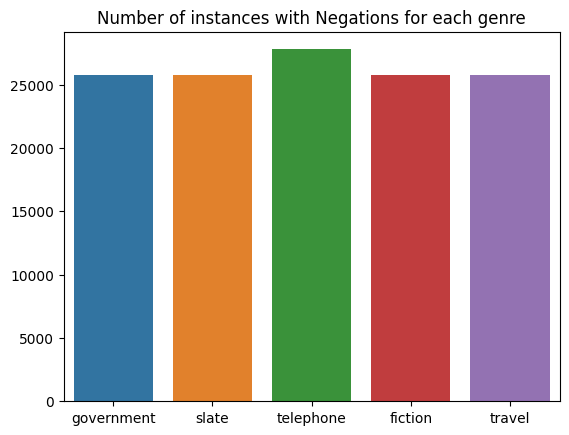

In [ ]:
genre_cwb_groups = cwb_df.groupby('genre')
genre = list(set(cwb_df['genre'].to_list()))
genre_cwb_counts = []

for gen in genre:
    genre_cwb_df = genre_cwb_groups.get_group(gen)
    genre_cwb_count = genre_cwb_df[genre_cwb_df['label']=='contradiction'].shape[0]
    genre_cwb_counts.append(genre_cwb_count)


# Create the bar plot
sns.barplot(x=genre, y=genre_cwb_counts)
plt.title(f'Number of instances with Negations for each genre')
plt.show()

Number of contradiction instances with negation: 50771
Number of entailment instances with negation: 17797
Number of neutral instances with negation: 19345


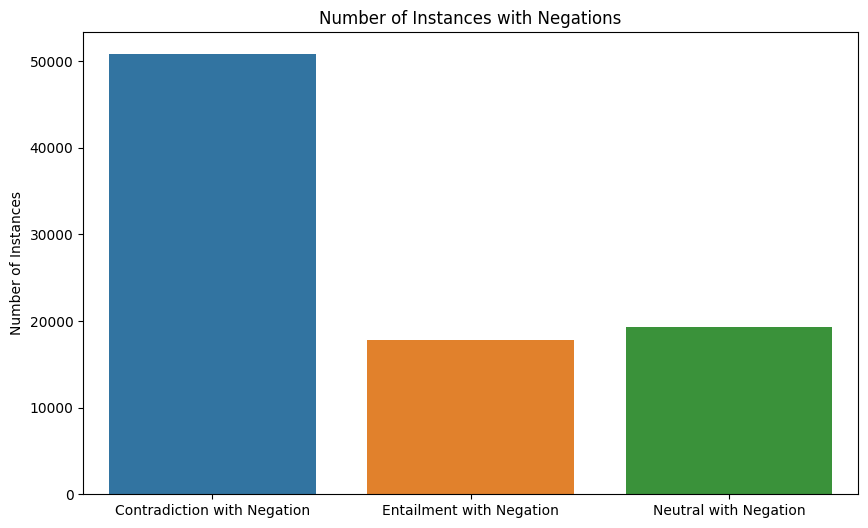

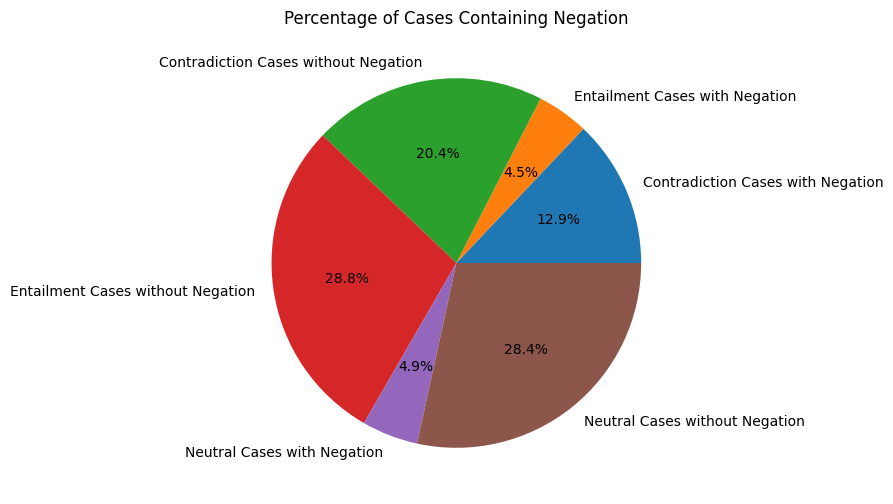

Total number of negation words in the contradiction instances 53282
Total number of negation words in the entailment instances 18573


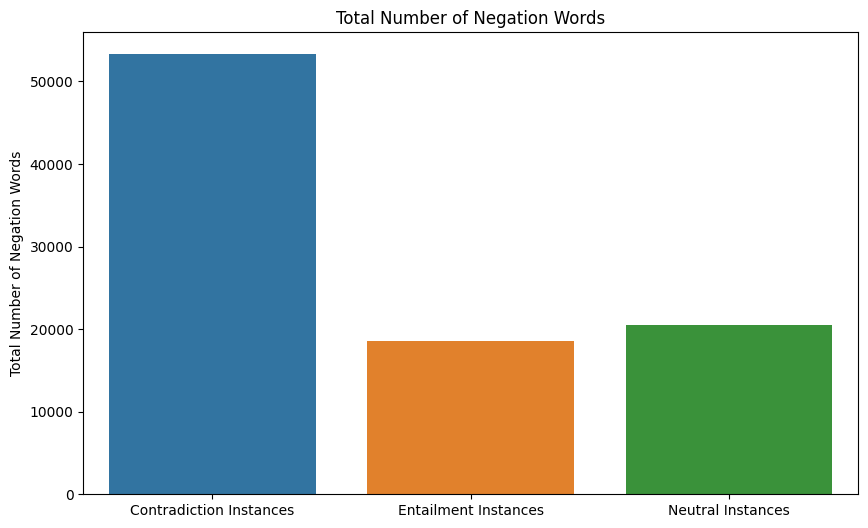

Percentage of contradiction cases with negation: 0.3878520736728723
Percentage of entailment cases with negation: 0.13595978578904347


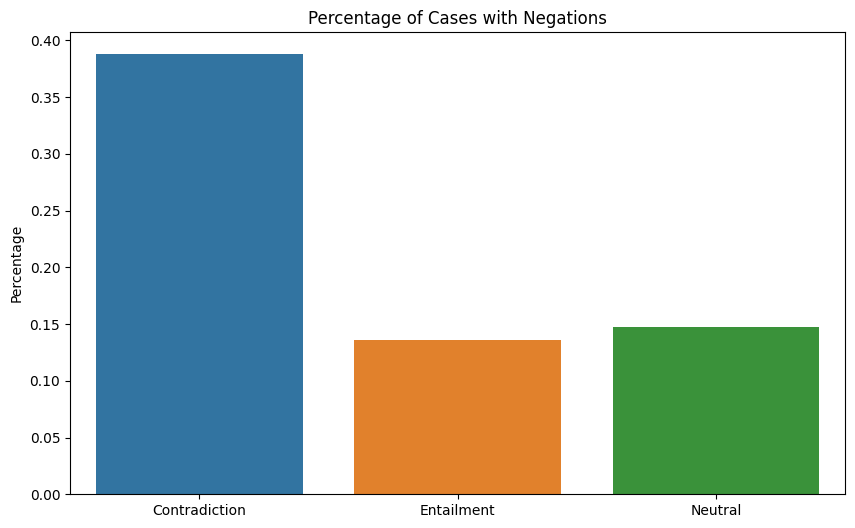

The average number of negations in entailment cases is 0.14188802053491623
The average number of negations in non-entailment cases is 0.4070342161753359
The average number of negations in neutral cases is 0.15621084797555385


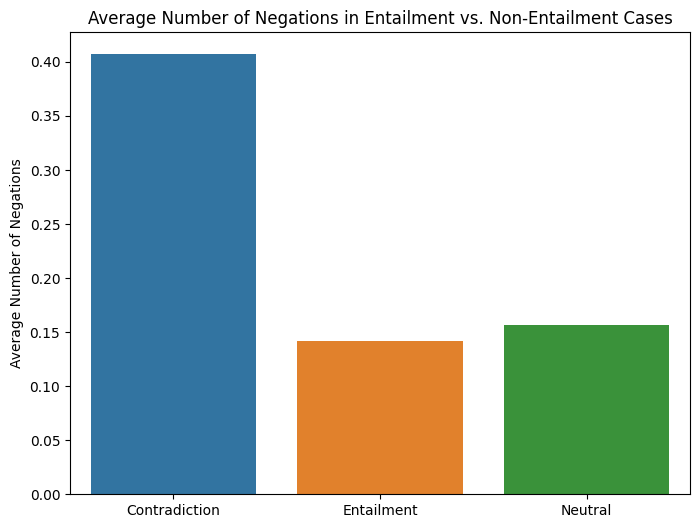

In [ ]:
# Bar Plot for number of cases with negations
print(f"Number of contradiction instances with negation: {contradiction_with_neg_instances.shape[0]}")
print(f"Number of entailment instances with negation: {entailment_with_neg_instances.shape[0]}")
print(f"Number of neutral instances with negation: {neutral_with_neg_instances.shape[0]}")
labels = ['Contradiction with Negation', 'Entailment with Negation', 'Neutral with Negation']
values = [contradiction_with_neg_instances.shape[0],
          entailment_with_neg_instances.shape[0],
          neutral_with_neg_instances.shape[0]]

plt.figure(figsize=(10, 6))
sns.barplot(x=labels, y=values)
plt.title('Number of Instances with Negations')
plt.ylabel('Number of Instances')
plt.show()

# Pie Chart of Cases with Negation
labels = ['Contradiction Cases with Negation', 'Entailment Cases with Negation', 'Contradiction Cases without Negation', 'Entailment Cases without Negation', 'Neutral Cases with Negation', 'Neutral Cases without Negation']
sizes = [contradiction_with_neg_instances.shape[0], entailment_with_neg_instances.shape[0], contradiction_without_neg_instances.shape[0], entailment_without_neg_instances.shape[0], neutral_with_neg_instances.shape[0], neutral_without_neg_instances.shape[0] ]
plt.figure(figsize=(8, 6))
plt.pie(sizes, labels=labels, autopct='%1.1f%%')
plt.title('Percentage of Cases Containing Negation')
plt.show()

# Bar Plot for total number of negations in contradiction and entailment instances
print(f"Total number of negation words in the contradiction instances {contradiction_with_neg_instances['negation_count'].sum()}")
print(f"Total number of negation words in the entailment instances {entailment_with_neg_instances['negation_count'].sum()}")
labels = ['Contradiction Instances', 'Entailment Instances', 'Neutral Instances']
values = [contradiction_with_neg_instances['negation_count'].sum(), entailment_with_neg_instances['negation_count'].sum(), neutral_with_neg_instances['negation_count'].sum()]

plt.figure(figsize=(10, 6))
sns.barplot(x=labels, y=values)
plt.title('Total Number of Negation Words')
plt.ylabel('Total Number of Negation Words')
plt.show()

# Bar Plot for percentage of cases with negations
print(f"Percentage of contradiction cases with negation: {contradiction_with_neg_instances.shape[0]/(total_contradiction_instances)}")
print(f"Percentage of entailment cases with negation: {entailment_with_neg_instances.shape[0]/(total_entailment_instances)}")
labels = ['Contradiction', 'Entailment', 'Neutral']
values = [contradiction_with_neg_instances.shape[0] / (total_contradiction_instances),
          entailment_with_neg_instances.shape[0] / (total_entailment_instances),
          neutral_with_neg_instances.shape[0] / (total_neutral_instances)]

plt.figure(figsize=(10, 6))
sns.barplot(x=labels, y=values)
plt.title('Percentage of Cases with Negations')
plt.ylabel('Percentage')
plt.show()


# Bar Chart of Average Negation Counts
print(f"The average number of negations in entailment cases is {avg_negations_entailment}")
print(f"The average number of negations in non-entailment cases is {avg_negations_non_entailment}")
print(f"The average number of negations in neutral cases is {avg_negations_neutral}")
plt.figure(figsize=(8, 6))
sns.barplot(x=['Contradiction', 'Entailment', 'Neutral'], y=[avg_negations_non_entailment, avg_negations_entailment, avg_negations_neutral])
plt.title('Average Number of Negations in Entailment vs. Non-Entailment Cases')
plt.ylabel('Average Number of Negations')
plt.show()



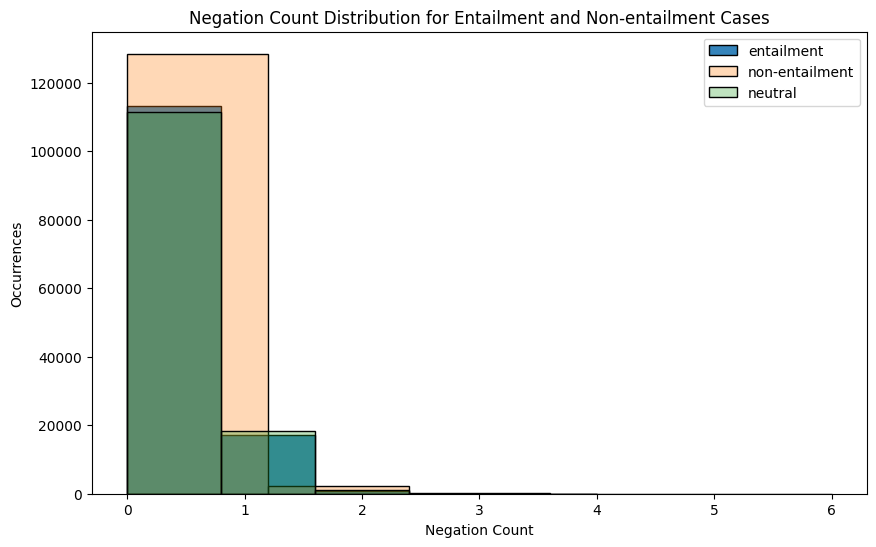

In [ ]:
# Histogram of Negation Counts for Entailment and Non-entailment Cases
plt.figure(figsize=(10, 6))

sns.histplot(entailment_df['negation_count'], label='entailment', bins=5, alpha=0.9)
sns.histplot(non_entailment_df['negation_count'], label='non-entailment', bins=5, alpha=0.3)
sns.histplot(neutral_df['negation_count'], label='neutral', bins=5, alpha=0.3)

plt.title('Negation Count Distribution for Entailment and Non-entailment Cases')
plt.xlabel('Negation Count')
plt.ylabel('Occurrences')
plt.legend(loc='upper right')

plt.show()


## Subsequence Heuristic bias

In [ ]:
ssb_df = mnli_train[['premise','hypothesis','label', 'genre']]

In [ ]:
def remove_punctuation(input_string):
    translator = str.maketrans('', '', string.punctuation)
    return input_string.translate(translator)

def detect_subsequence(premise: str, hypothesis: str) -> Tuple[str, bool]:
    premise_words = remove_punctuation(premise.lower())
    hypothesis_words = remove_punctuation(hypothesis.lower())
    # Add word boundaries to the hypothesis
    hypothesis_words = r"\b" + hypothesis_words + r"\b"
    if re.search(hypothesis_words, premise_words):
        return (hypothesis, True)
    else:
        return ("", False)

In [ ]:
# test cases for the subsequence heuristic function

def test_detect_subsequence():
    result = detect_subsequence(
        "The artist and the student called the judge.",
        "The student called the judge.")
    assert result == ("The student called the judge.", True), f'Expected ("The student called the judge.", True), but got {result}'
    result = detect_subsequence(
        "The judges heard the actors resigned.",
        "The judges heard the actors")
    assert result == ("The judges heard the actors", True), f'Expected ("The judges heard the actors", True), but got {result}'
    result = detect_subsequence(
        "The judges heard the actors resigned.",
        "The judges and the actors resigned")
    assert result == ("", False), f'Expected ("", False), but got {result}'
    result = detect_subsequence(
        "The artist and the student called the judge.",
        "The artist called the judge")
    assert result == ("", False), f'Expected ("", False), but got {result}'
    result = detect_subsequence(
        "The artist and the student called the judge.",
        "The student called")
    assert result == ("The student called", True), f'Expected ("The student called", True), but got {result}'
    result = detect_subsequence(
        "The artist and the student called the judge.",
        "The judge called the student")
    assert result == ("", False), f'Expected ("", False), but got {result}'
    print("All tests passed.")

test_detect_subsequence()

All tests passed.


In [ ]:
ssb_df['detected_subsequence'], ssb_df['is_subsequence_heuristic'] = zip(*ssb_df.apply(lambda row: detect_subsequence(row['premise'], row['hypothesis']), axis=1))

<ipython-input-67-1e6a2af21e2f>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-67-1e6a2af21e2f>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
ssb_df['detected_subsequence'][ssb_df['detected_subsequence']!=""].head(30)

614                           They were pushing the pace.
753                             Worry about my youngster.
908     The point of David Frum's argument in the Gay ...
1015                                              Sit up.
1114                                     I have two boys.
1170    The major hardware for an FGD system includes ...
1249    Value of reallocated allowances can be calcula...
1469                                           Enjoy it! 
1567              Las vegas was built to serve travelers.
1691    Saving the Social Security surpluses produces ...
1737    Elemental load time varies with the number of ...
1880           The act sets up a series of pilot audits. 
2044                     The clerk had on a summer dress.
2320    The PDFA's campaign has sunk in at major newsr...
2463                             What branch were you in?
2856                                   Champagne-Ardennes
2867                            Because you're having fun
3189     the F

In [ ]:
ssb_df_entailment = ssb_df[(ssb_df['is_subsequence_heuristic']==True) & (ssb_df['label']=='entailment')]
ssb_df_contradiction = ssb_df[(ssb_df['is_subsequence_heuristic']==True) & (ssb_df['label']=='contradiction')]
ssb_df_neutral = ssb_df[(ssb_df['is_subsequence_heuristic']==True) & (ssb_df['label']=='neutral')]

print(f"Number of entailment cases with subsequence heuristic: {ssb_df_entailment.shape[0]}")
print(f"Number of contradiction cases with subsequence heuristic: {ssb_df_contradiction.shape[0]}")
print(f"Number of neutral cases with subsequence heuristic: {ssb_df_neutral.shape[0]}")

Number of entailment cases with subsequence heuristic: 2360
Number of contradiction cases with subsequence heuristic: 50
Number of neutral cases with subsequence heuristic: 83


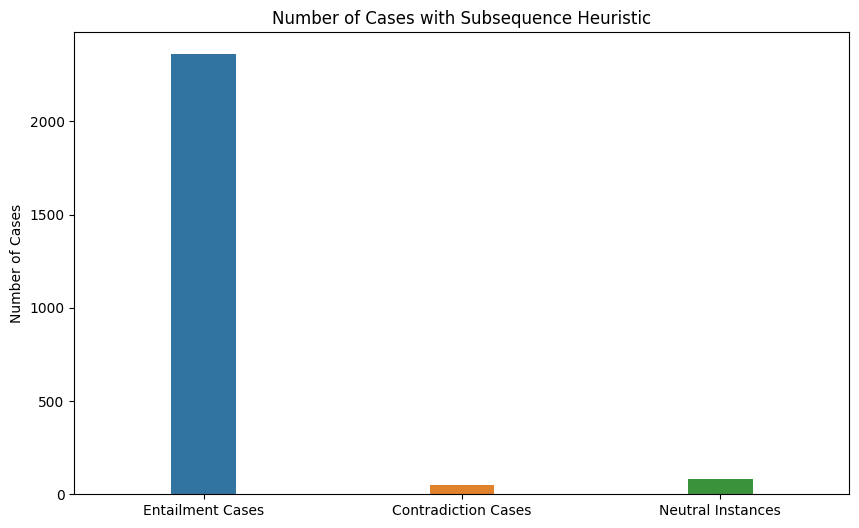

In [ ]:
# Bar Plot for number of cases with subsequence heuristic
labels = ['Entailment Cases', 'Contradiction Cases', 'Neutral Instances']
values = [ssb_df_entailment.shape[0], ssb_df_contradiction.shape[0], ssb_df_neutral.shape[0] ]

plt.figure(figsize=(10, 6))
sns.barplot(x=labels, y=values, width=0.25)
plt.title('Number of Cases with Subsequence Heuristic')
plt.ylabel('Number of Cases')
plt.show()
